In [1]:
import json
import jsonlines
import os
import torch
import numpy as np
import os
import json
from tqdm import tqdm
import re
import cv2
from IPython.display import display
import PIL.Image as Image
import math
import matplotlib.pyplot as plt
from multiprocessing import get_context
from terminaltables import AsciiTable
import pdb
import helper
try:
    from mmcv.utils import print_log
except ImportError:
    from mmengine.logging import print_log


Image.MAX_IMAGE_PIXELS = None
root = os.getcwd()

/home/zilun/anaconda3/envs/imagerag/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


[2024-12-26 16:07:50,920] [INFO] [real_accelerator.py:191:get_accelerator] Setting ds_accelerator to cuda (auto detect)


In [2]:
fit_image_root = "/media/zilun/fanxiang4t/GRSM/evaluation_dataset/VQA_VG/FIT/FIT-RS/FIT-RS_Instruction/FIT-RS_Img/imgv2_split_512_100_vaild"
para5_fit_question_path = "/media/zilun/fanxiang4t/GRSM/ImageRAG_git/data/eval/test_FITRS_complex_comprehension_eval_5para_complete_fit.jsonl"
para5_fit_eval_path = "/media/zilun/fanxiang4t/GRSM/ImageRAG_git/data/eval/test_FITRS_complex_comprehension_eval_5para_complete_fit_eval.jsonl"
# para5_fit_eval_path = "/media/zilun/fanxiang4t/GRSM/ov/inference/rsvqa/result/skysensegpt-fullft-1e6/FITRS_complex_comprehension_eval_skysensegpt-fullft-1e6.jsonl"

In [3]:
def read_eval_jsonl(jsonl_path):
    base = [json.loads(q) for q in open(jsonl_path, "r")]
    return base

In [4]:
para5_fit_question = read_eval_jsonl(para5_fit_question_path)
para5_fit_eval = read_eval_jsonl(para5_fit_eval_path)

In [5]:
def fit_denormalization(rbbox, image_w=512, image_h=512):
    """obb2poly_np_oc_2rad
    rbbox: normalzied rbbox
    return: unnormalized rbbox (deg angle)
    """
    cx, cy, w, h, angle_deg = rbbox
    cx = cx / 100 * image_w
    cy = cy / 100 * image_h
    w = w / 100 * image_w
    h = h / 100 * image_h
    # angle_rad = math.radians(angle_deg)
    return cx, cy, w, h, angle_deg

In [6]:
def obb2poly_np_oc_2rad(rbbox):
    """Convert oriented bounding boxes to polygons.

    Args:
        obbs (ndarray): [x_ctr,y_ctr,w,h,angle,score]

    Returns:
        polys (ndarray): [x0,y0,x1,y1,x2,y2,x3,y3,score]
    """
    x = rbbox[0]
    y = rbbox[1]
    w = rbbox[2]
    h = rbbox[3]
    a = np.radians(rbbox[4])
    cosa = np.cos(a)
    sina = np.sin(a)
    wx, wy = w / 2 * cosa, w / 2 * sina
    hx, hy = -h / 2 * sina, h / 2 * cosa
    p1x, p1y = x - wx - hx, y - wy - hy
    p2x, p2y = x + wx - hx, y + wy - hy
    p3x, p3y = x + wx + hx, y + wy + hy
    p4x, p4y = x - wx + hx, y - wy + hy
    polys = np.array([p1x, p1y, p2x, p2y, p3x, p3y, p4x, p4y])
    return polys.tolist()


def obb2poly_np_oc_2rad_obb2(rbbox):
    """Convert oriented bounding boxes to polygons.

    Args:
        obbs (ndarray): [x_ctr,y_ctr,w,h,angle,score]

    Returns:
        polys (ndarray): [x0,y0,x1,y1,x2,y2,x3,y3,score]
    """
    x1 = rbbox[0]
    y1 = rbbox[1]
    x2 = rbbox[2]
    y2 = rbbox[3]

    x = (x1 + x2) / 2
    y = (y1 + y2) / 2
    w = x2 - x1
    h = y2 - y1 
    
    a = np.radians(rbbox[4])
    cosa = np.cos(a)
    sina = np.sin(a)
    wx, wy = w / 2 * cosa, w / 2 * sina
    hx, hy = -h / 2 * sina, h / 2 * cosa
    p1x, p1y = x - wx - hx, y - wy - hy
    p2x, p2y = x + wx - hx, y + wy - hy
    p3x, p3y = x + wx + hx, y + wy + hy
    p4x, p4y = x - wx + hx, y - wy + hy
    polys = np.array([p1x, p1y, p2x, p2y, p3x, p3y, p4x, p4y])
    return polys.tolist()


def rbbox_to_corners(rbbox):
    # https://blog.csdn.net/W1995S/article/details/115583492
    cx, cy, w, h, angle_deg = rbbox
    angle_rad = math.radians(angle_deg)
    cos_theta = math.cos(angle_rad)
    sin_theta = math.sin(angle_rad)
    c = np.array([cx, cy]).reshape(-1, 1)
    v = np.array(
        [
            [-w / 2, -h /2],
            [-w / 2, h / 2],
            [w / 2, h / 2],
            [w / 2, -h / 2],
        ]
    ).T
    rotation_matrix = np.array(
        [
            [cos_theta, -sin_theta],
            [sin_theta, cos_theta]
        ]
    )
    corners = rotation_matrix @ v + c
    corners = corners.T.flatten().tolist()
    return corners

In [7]:
def visualize_rbbox(image, rbbox, color):
    """
    denormalized rbbox
    """
    print("Rbbox Vertices: {}".format(rbbox))
    vertices = np.array(
        [
            [int(rbbox[0]), int(rbbox[1])],
            [int(rbbox[2]), int(rbbox[3])],
            [int(rbbox[4]), int(rbbox[5])],
            [int(rbbox[6]), int(rbbox[7])],
        ]
    )
    print(vertices)
    cv2.polylines(image, [vertices], isClosed=True, color=color, thickness=1)
    return image

In [8]:
def visualize_fit(example, image_root):
    print("FIT Dataset Vis......")
    question_id = example["question_id"]
    image_id = example["image_id"]
    task_category = example["category"]
    gt = example["ground_truth"]
    gt_coords = extract_coord(gt)
    prediction = example["answer"]
    prediction_coords = extract_coord(prediction)
    
    image = cv2.imread(os.path.join(image_root, image_id), cv2.IMREAD_UNCHANGED)
    height, width = image.shape[0], image.shape[1]
    for gt_rbox in gt_coords:
        print("gt_rbox: {}".format(gt_rbox))
        rbbox_denorm_5param = fit_denormalization(gt_rbox, width, height)
        print("rbbox_denorm_5param: {}".format(rbbox_denorm_5param))
        rbbox_denorm_8param = obb2poly_np_oc_2rad(rbbox_denorm_5param)
        print("rbbox_denorm_8param: {}".format(rbbox_denorm_8param))
        image = visualize_rbbox(image, rbbox_denorm_8param, color=(0, 255, 0))
        print()
    print()
    for pred_rbox in prediction_coords:
        print("pred_rbox: {}".format(pred_rbox))
        rbbox_denorm_5param = fit_denormalization(gt_rbox, width, height)
        print("rbbox_denorm_5param: {}".format(rbbox_denorm_5param))
        rbbox_denorm_8param = obb2poly_np_oc_2rad(rbbox_denorm_5param)
        print("rbbox_denorm_8param: {}".format(rbbox_denorm_8param))
        image = visualize_rbbox(image, rbbox_denorm_8param, color=(0, 0, 255))
        print()
    return image
    

def show_vis_result(image, para5_star_example, para5_star_question_example):
    for k, v in para5_star_example.items():
        print("{}: {}".format(k, v))
    for k, v in para5_star_question_example.items():
        print("{}: {}".format(k, v))

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
    # plt.imshow(image)
    # plt.axis('off')  # 关闭坐标轴
    # plt.show()
    display(Image.fromarray(image))

In [9]:
def extract_coord(input_str):
    pattern = r'\{(<.*?>)\}'
    # 使用正则表达式找到所有的矩形框
    matches = re.findall(pattern, input_str)
    rbox_list = []
    for match in matches:
        numbers_str = re.findall(r'<(.*?)>', match)
        # 将数字转换为浮点数，并将角度转换为弧度
        rbox = np.array(numbers_str, dtype=np.float32)
        rbox_list.append(rbox)
    return np.array(rbox_list)

In [10]:
def poly2obb_np_oc(poly):
    """Convert polygons to oriented bounding boxes.

    Args:
        polys (ndarray): [x0,y0,x1,y1,x2,y2,x3,y3]

    Returns:
        obbs (ndarray): [x_ctr,y_ctr,w,h,angle]
    """
    bboxps = np.array(poly).reshape((4, 2))
    rbbox = cv2.minAreaRect(bboxps)
    x, y, w, h, a = rbbox[0][0], rbbox[0][1], rbbox[1][0], rbbox[1][1], rbbox[
        2]
    while not 0 < a <= 90:
        if a == -90:
            a += 180
        else:
            a += 90
            w, h = h, w
    a = a / 180 * np.pi
    assert 0 < a <= np.pi / 2
    return x, y, w, h, a

In [11]:
len(para5_fit_question), len(para5_fit_eval)

(11174, 11174)

In [12]:
def merge_q_gt(q_jsonl, a_jsonl):
    qagt_dict = dict()
    for q in tqdm(q_jsonl):
        q_id = q["question_id"]
        qagt_dict[q_id] = q
        for a in a_jsonl:
            if a["question_id"] == q_id:
                qagt_dict[q_id]["answer"] = a["answer"]
    return qagt_dict

In [13]:
qagt_dict = merge_q_gt(para5_fit_question, para5_fit_eval)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11174/11174 [00:04<00:00, 2762.41it/s]


In [14]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def draw_rotated_box(ax, vertices, color='red', alpha=0.5):
    box = patches.Polygon(np.array(vertices).reshape(-1, 2), closed=True, edgecolor=color, facecolor='none', linewidth=2, alpha=alpha)
    ax.add_patch(box)
    

def visualize_rotated_bboxes(image_path, gt_boxes, pred_bboxes):
    # 读取图像
    img = plt.imread(image_path)
    
    # 创建一个1行2列的子图
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    
    # 可视化真实旋转边界框
    axs[0].imshow(img)
    axs[0].set_title('Ground Truth Rotated BBoxes')
    for bbox in gt_boxes:
        draw_rotated_box(axs[0], bbox, color='red')
    axs[0].axis('off')  # 关闭坐标轴
    # 在子图下方显示图片路径
    axs[0].set_xlabel(image_path)
    
    # 可视化预测旋转边界框
    axs[1].imshow(img)
    axs[1].set_title('Prediction Rotated BBoxes')
    for bbox in pred_bboxes:
        draw_rotated_box(axs[1], bbox, color='blue')
    axs[1].axis('off')  # 关闭坐标轴
    # 在子图下方显示图片路径
    axs[1].set_xlabel(image_path)
    
    # 调整子图间距
    plt.tight_layout()
    
    # 显示图像
    plt.show()


In [15]:
def normalized_bbox2obb(normalized_bbox, image_w=512, image_h=512):
    denormed_bbox = fit_denormalization(normalized_bbox, image_w, image_h)
    poly = obb2poly_np_oc_2rad(denormed_bbox)
    return poly
    

def parse_gt_answer(qagt_dict, image_root, task_id="task4", vis_num=10):
    count_vis = 1
    for question_id, example in tqdm(qagt_dict.items()):
        if example["category"] == task_id:
            question = example["question"]
            image_id = example["image"]
            task_category = example["category"]
            gt = example["ground_truth"]
            gt_coords = extract_coord(gt)
            gt_coords = [normalized_bbox2obb(gt_coord) for gt_coord in gt_coords]
            prediction = example["answer"]
            prediction_coords = extract_coord(prediction)
            prediction_coords = [normalized_bbox2obb(prediction_coord) for prediction_coord in prediction_coords]
            print("Image ID: {}".format(image_id))
            print("{} gt boxes; {} prediction boxes".format(len(gt_coords), len(prediction_coords)))
            print("Question: {}".format(question))
            print("Answer: {}".format(prediction))
            print("Ground Truth: {}".format(gt))
            visualize_rotated_bboxes(os.path.join(image_root, image_id), gt_coords, prediction_coords)
            print()
            count_vis += 1
            if count_vis > vis_num:
                break

            # image = cv2.imread(os.path.join(image_root, image_id), cv2.IMREAD_UNCHANGED)
            # height, width = image.shape[0], image.shape[1]
            # for gt_rbox in gt_coords:
            #     print("gt_rbox: {}".format(gt_rbox))
            #     rbbox_denorm_5param = fit_denormalization(gt_rbox, width, height)
            #     print("rbbox_denorm_5param: {}".format(rbbox_denorm_5param))
            #     rbbox_denorm_8param = obb2poly_np_oc_2rad(rbbox_denorm_5param)
            #     print("rbbox_denorm_8param: {}".format(rbbox_denorm_8param))
            #     image = visualize_rbbox(image, rbbox_denorm_8param, color=(0, 255, 0))
            #     image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
            #     display(Image.fromarray(image))
            #     exit()
            # print()
            # for pred_rbox in prediction_coords:
            #     print("pred_rbox: {}".format(pred_rbox))
            #     rbbox_denorm_5param = fit_denormalization(gt_rbox, width, height)
            #     print("rbbox_denorm_5param: {}".format(rbbox_denorm_5param))
            #     rbbox_denorm_8param = obb2poly_np_oc_2rad(rbbox_denorm_5param)
            #     print("rbbox_denorm_8param: {}".format(rbbox_denorm_8param))
            #     image = visualize_rbbox(image, rbbox_denorm_8param, color=(0, 0, 255))
            #     exit()


  0%|                                                                                                                                                                                                                                                   | 0/11174 [00:00<?, ?it/s]

Image ID: 0824__512__4120___4128.png
1 gt boxes; 1 prediction boxes
Question: [reasoning]There are some cars that are <rel>driving in the same direction with</rel> the object present at <rbox>({<31.45><47.17><4.98><15.66>|<63>})</rbox>. Could you tell me their locations?
Answer: There is 1 car in total. All coordinates: <rbox>({<51.56><34.18><2.97><7.44>|<66>})</rbox>.
Ground Truth: There is 1 car in total. All coordinates: <rbox>({<37.99><38.87><3.85><7.56>|<65>})</rbox>.


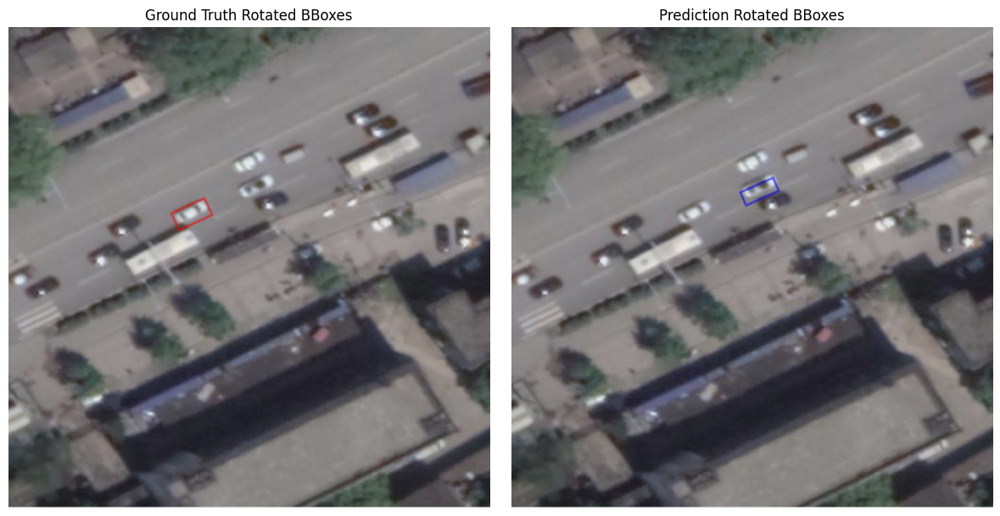

  0%|                                                                                                                                                                                                                                           | 2/11174 [00:00<23:00,  8.09it/s]


Image ID: 0873__512__412___4120.png
0 gt boxes; 0 prediction boxes
Question: [reasoning]Assist me in locating the position of all the objects <rel>adjacent</rel> the object in <rbox>({<8.79><31.15><3.33><6.46>|<86>})</rbox>.
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.


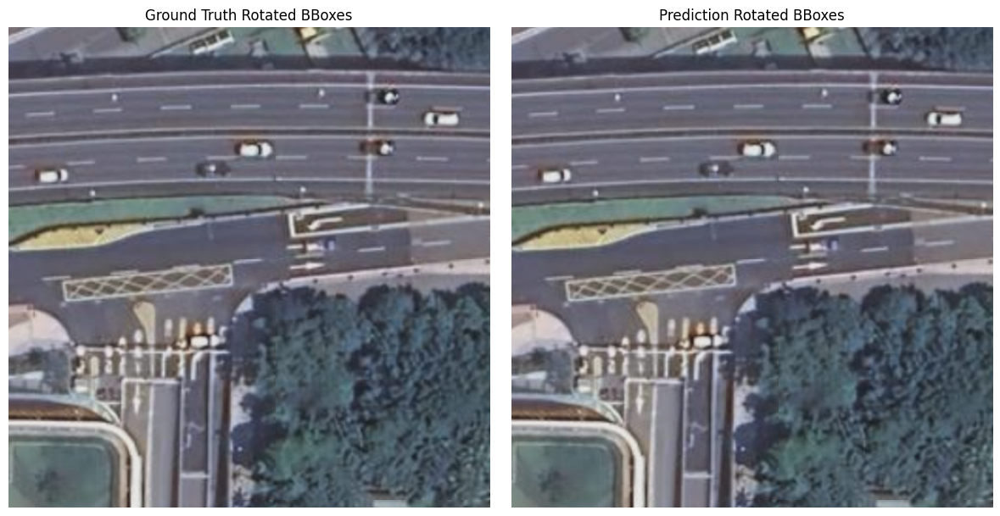

  0%|                                                                                                                                                                                                                                           | 5/11174 [00:00<17:47, 10.46it/s]


Image ID: 0842__512__5356___4120.png
2 gt boxes; 1 prediction boxes
Question: [reasoning]Output the positions of all objects that have a relationship of <rel>driving in the same direction with</rel> with the object present at <rbox>({<59.11><34.00><6.28><2.88>|<28>})</rbox>.
Answer: There is 1 object in total. All categories and coordinates: 1 car<rbox>({<50.10><28.81><6.41><2.65>|<32>})</rbox>.
Ground Truth: There are 2 objects in total. All coordinates: <rbox>({<62.50><27.54><8.07><3.06>|<25>}, {<57.03><29.00><6.28><2.62>|<28>})</rbox>.


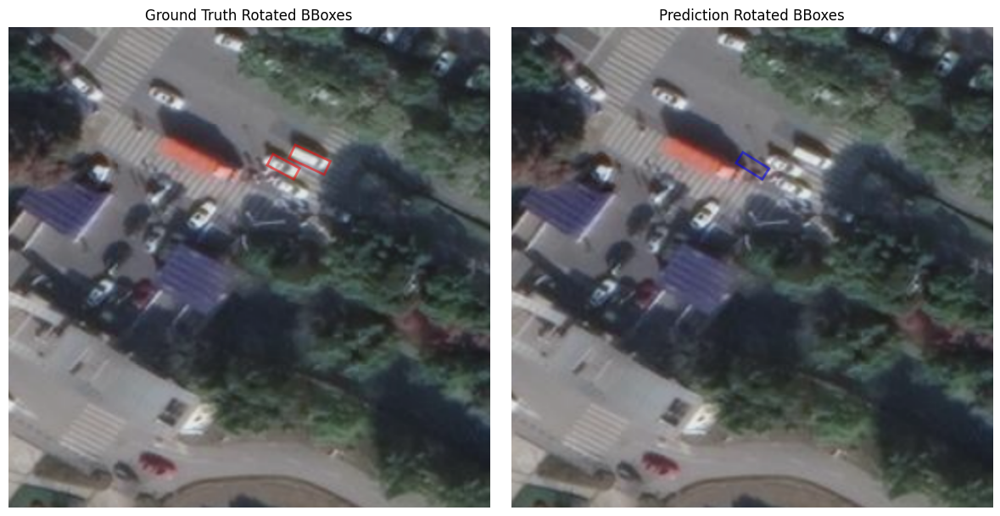

  0%|▏                                                                                                                                                                                                                                          | 8/11174 [00:00<16:38, 11.18it/s]


Image ID: 0873__512__2472___0.png
8 gt boxes; 2 prediction boxes
Question: [reasoning]Point out the cars that are <rel>parked alongside with</rel> the car in the image. Where can I find them?
Answer: There are 2 cars in total. All coordinates: <rbox>({<2.83><85.16><7.03><3.91>|<90>}, {<9.47><91.99><7.12><3.12>|<88>})</rbox>.
Ground Truth: There are 8 cars in total. All coordinates: <rbox>({<3.91><91.70><2.35><7.65>|<85>}, {<11.82><90.72><2.35><7.60>|<82>}, {<4.39><84.08><6.60><3.15>|<81>}, {<8.48><74.42><3.15><6.88>|<83>}, {<8.20><71.09><2.61><6.22>|<77>}, {<6.54><68.36><2.73><6.84>|<90>}, {<5.47><64.36><2.84><6.50>|<74>}, {<4.41><61.00><2.80><6.82>|<77>})</rbox>.


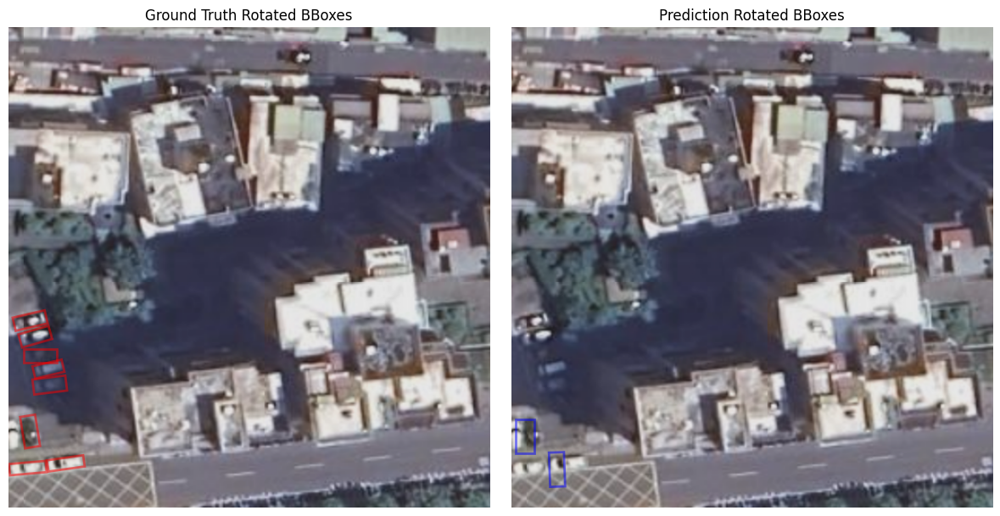

  0%|▏                                                                                                                                                                                                                                         | 10/11174 [00:00<18:48,  9.89it/s]


Image ID: 0041__512__824___824.png
1 gt boxes; 1 prediction boxes
Question: [reasoning]Could you help me find all the objects that have a relationship of <rel>docked alongside with</rel> with the object in <rbox>({<7.62><96.97><7.35><1.66>|<46>})</rbox>? Please provide their locations and categories.
Answer: There is 1 object in total. All categories and coordinates: 1 boat<rbox>({<6.48><97.88><7.04><1.93>|<45>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>boat</ref><rbox>({<6.56><98.17><7.74><1.66>|<47>})</rbox>.


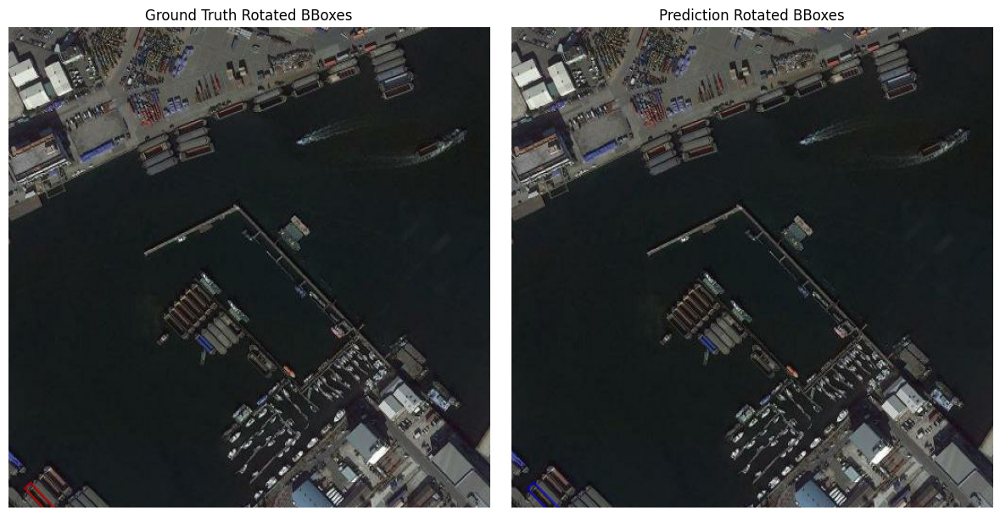

  0%|▍                                                                                                                                                                                                                                         | 20/11174 [00:01<08:19, 22.35it/s]


Image ID: 0977__512__2060___4532.png
1 gt boxes; 1 prediction boxes
Question: [reasoning]What objects have the relationship of <rel>parked alongside with</rel> with the <ref>car</ref> present at <rbox>({<95.70><69.63><6.09><3.32>|<60>})</rbox>? Could you locate and classify them for me?
Answer: There is 1 object in total. All categories and coordinates: 1 car<rbox>({<83.01><74.61><6.64><3.32>|<61>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>car</ref><rbox>({<82.21><74.94><6.45><2.93>|<53>})</rbox>.


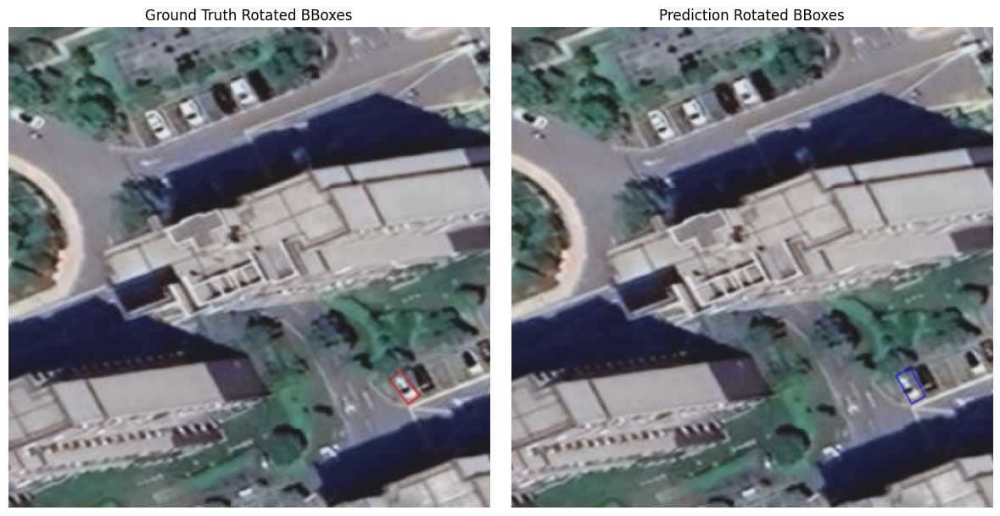

  0%|▍                                                                                                                                                                                                                                         | 23/11174 [00:01<09:51, 18.84it/s]


Image ID: 0021__512__2884___2884.png
1 gt boxes; 1 prediction boxes
Question: [reasoning]Detect all the objects that have a relationship <rel>connect</rel> with the <ref>boarding_bridge</ref> in <rbox>({<10.09><21.21><8.41><9.28>|<30>})</rbox> and output their locations.
Answer: There is 1 object in total. All categories and coordinates: 1 airplane<rbox>({<11.28><30.81><12.99><11.47>|<47>})</rbox>.
Ground Truth: There is 1 object in total. All coordinates: <rbox>({<10.44><30.13><14.64><15.71>|<30>})</rbox>.


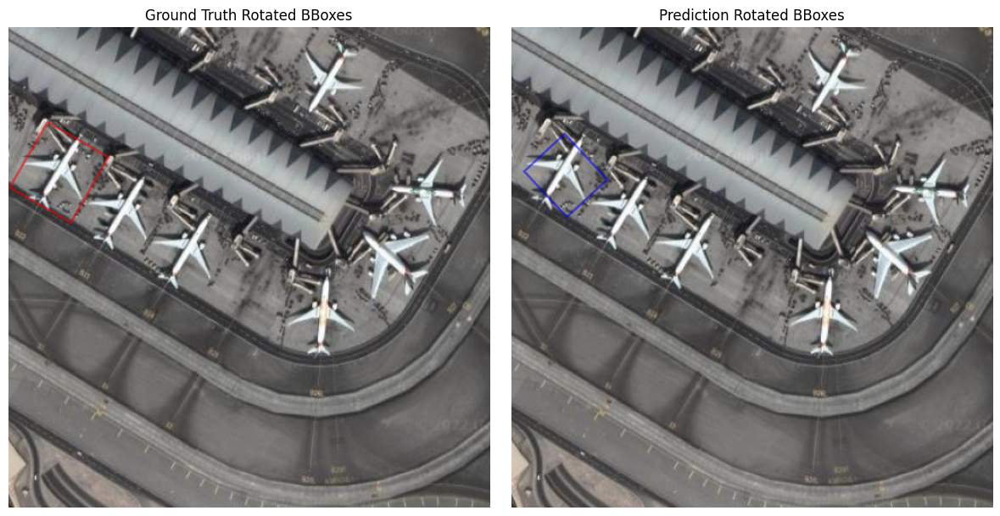


Image ID: 0739__512__6180___3708.png
6 gt boxes; 2 prediction boxes
Question: [reasoning]Please locate all the ships that are <rel>parallelly docked at</rel> the dock and provide their coordinates.
Answer: There are 2 ships in total. All coordinates: <rbox>({<62.50><37.21><4.69><15.05>|<2>}, {<89.55><27.95><2.35><10.37>|<3>})</rbox>.
Ground Truth: There are 6 ships in total. All coordinates: <rbox>({<61.52><65.62><2.99><12.56>|<9>}, {<58.30><65.14><3.56><12.34>|<10>}, {<55.27><66.02><2.18><10.33>|<9>}, {<52.34><67.38><2.99><10.18>|<10>}, {<48.84><69.86><2.76><8.35>|<10>}, {<47.75><60.64><10.39><2.80>|<78>})</rbox>.


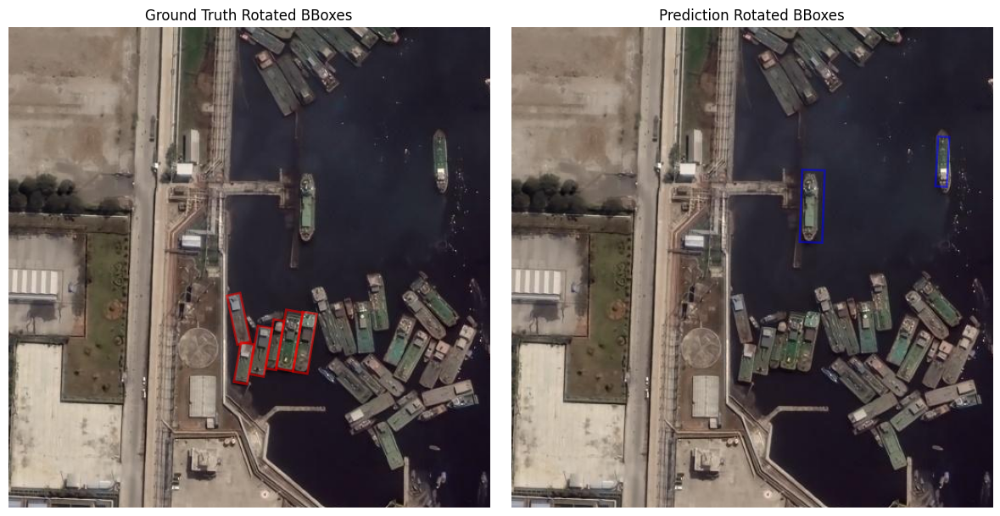

  0%|▌                                                                                                                                                                                                                                         | 26/11174 [00:01<14:14, 13.05it/s]


Image ID: 1256__512__3296___1236.png
0 gt boxes; 0 prediction boxes
Question: [reasoning]Point out the objects that are <rel>indirectly transmit electricity to</rel> the intersection in the image. Where can I find them?
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.


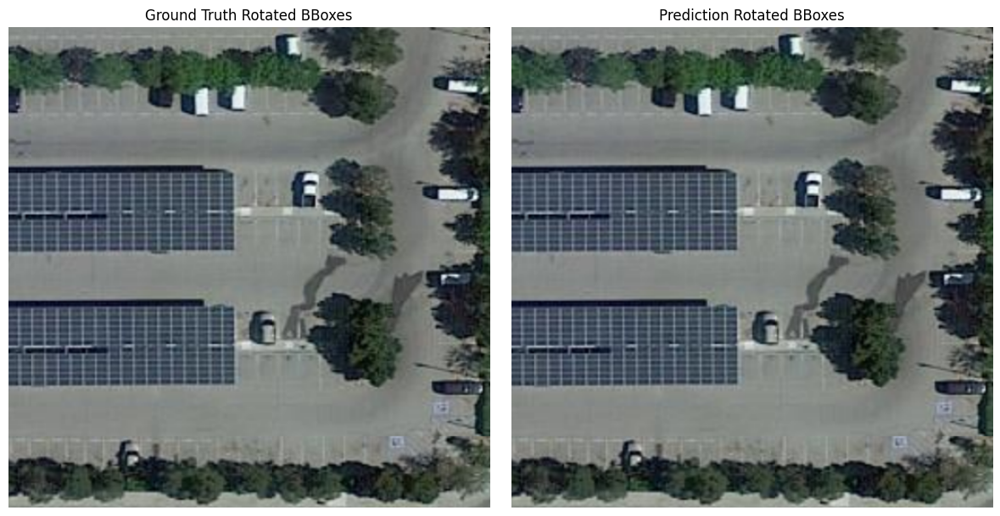

  0%|▌                                                                                                                                                                                                                                         | 28/11174 [00:02<15:36, 11.90it/s]


Image ID: 0018__512__2060___2884.png
0 gt boxes; 0 prediction boxes
Question: [reasoning]Identify and provide the coordinates of all objects that are <rel>pass through</rel> the <ref>boarding_bridge</ref> present at <rbox>({<97.44><34.99><4.72><3.66>|<60>})</rbox> in the image.
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.


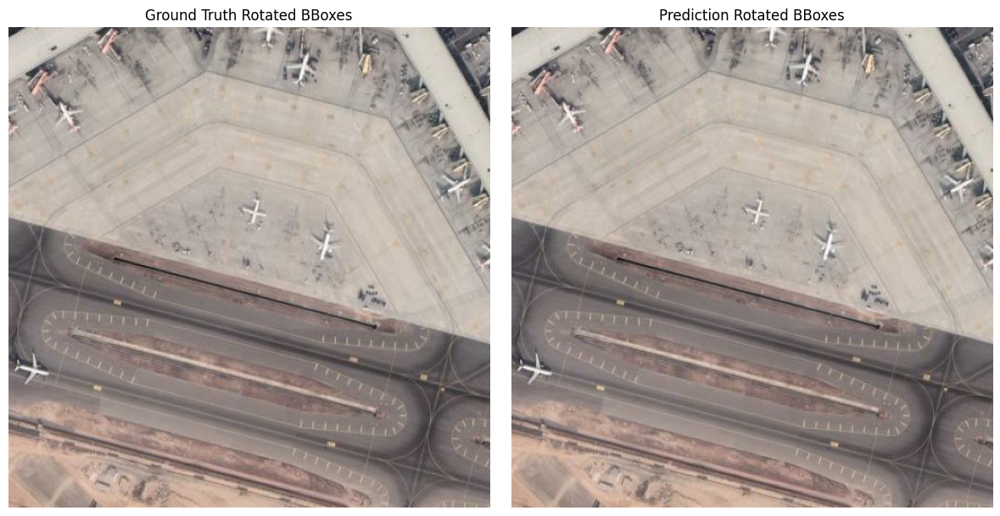

  0%|▋                                                                                                                                                                                                                                         | 32/11174 [00:02<13:43, 13.54it/s]

In [16]:
parse_gt_answer(qagt_dict, fit_image_root, task_id="task4", vis_num=10)

In [17]:
# image = cv2.imread(os.path.join(fit_image_root, "0824__512__4120___4128.png"), cv2.IMREAD_UNCHANGED)
# rbbox_5param_obb1 = np.array([51.56, 34.18, 2.97, 7.44, 66])
# rbbox_denorm_5param_obb1 = fit_denormalization(rbbox_5param_obb1, 512, 512)
# rbbox_denorm_8param_obb1 = obb2poly_np_oc_2rad(rbbox_denorm_5param_obb1)
# image_obb1 = visualize_rbbox(image, rbbox_denorm_8param_obb1, color=(0, 255, 0))
# image_obb1 = cv2.cvtColor(image_obb1, cv2.COLOR_BGR2RGB) # Converting BGR to RGB
# display(Image.fromarray(image_obb1))

In [18]:
# ## all categories
label_id = ['airplane', 'boat', 'taxiway', 'boarding_bridge', 'tank', 'ship', 'crane',
            'car', 'apron', 'dock', 'storehouse', 'goods_yard', 'truck', 'terminal',
            'runway', 'breakwater', 'car_parking', 'bridge', 'cooling_tower',
            'truck_parking', 'chimney', 'vapor', 'coal_yard', 'genset', 'smoke',
            'gas_station', 'lattice_tower', 'substation', 'containment_vessel', 'flood_dam', 'ship_lock', 'gravity_dam',
            'arch_dam', 'cement_concrete_pavement', 'toll_gate', 'tower_crane', 'engineering_vehicle', 'unfinished_building', 'foundation_pit',
            'wind_mill', 'intersection', 'roundabout', 'ground_track_field', 'soccer_ball_field', 'basketball_court', 'tennis_court', 'baseball_diamond', 'stadium']

# ## all relationships
relations = ['over', 'not co-storage with', 'connect', 'parallelly parked on', 'intersect', 'co-storage with', 'converge','parallelly docked at', 'adjacent', 'within safe distance of', 'through', 'approach', 'away from', 'randomly parked on', 'run along', 'isolatedly parked on', 'around', 'randomly docked at', 'drive off',
             'drive toward', 'within danger distance of','supply to','isolatedly docked at','pass across','not run along','slightly emit','exhaust to','violently emit',
             'incorrectly parked on', 'pass under', 'directly transmit electricity to','indirectly transmit electricity to', 'pass through','within same line of', 'within different line of','directly connected to','indirectly connected to','driving in the same direction with',
             'driving in the opposite direction with', 'driving alongside with','driving in the same lane with','driving in the different lane with','working on','not working on','parked alongside with','not parked alongside with',
             'in the same parking with','in the different parking with','parking in the same apron with','parking in the different apron with','running along the same taxiway with','running along the different taxiway with',
             'running along the different runway with','docking at the same breakwater with','docking at the same dock with','docking at the different dock with','docked alongside with','not docked alongside with']

label_id_to_index = {label: index for index, label in enumerate(label_id)}
relation_to_index = {relation: index for index, relation in enumerate(relations)}


def parse_multi_catgory_rbox(input_string, add_score = False):
    # 提取所有的目标类别和对应的rbox
    pattern = r'<ref>(.*?)</ref><rbox>\((.*?)\)</rbox>'
    matches = re.findall(pattern, input_string)
    categories = []
    rboxes = []
    for match in matches:
        # 提取类别，并转换为对应的label_id
        category = match[0]
        if category.endswith('s'):
            category = category[:-1]
        category_id = label_id_to_index.get(category, -1)
        categories.append(category_id)
        # 提取rbox，并转换为numpy数组
        rbox_strs = match[1]
        tmp_rboxes = extract_multi_rboxes_from_str(rbox_strs)
        num_obj = tmp_rboxes.shape[0]
        for i in range(num_obj):
            rbox = tmp_rboxes[i]
            if add_score:
                rbox = np.append(rbox, 1.0)
            if filter_rbox(rbox):
                rboxes.append(rbox)

    if len(rboxes) > 0:
        rboxes_categories = list(zip(map(tuple, rboxes), categories))
        rboxes_categories = list(dict.fromkeys(rboxes_categories))
        rboxes, categories = zip(*rboxes_categories)
        rboxes = [np.array(rbox) for rbox in rboxes]

    det_result_per_image = [{'bbox': rbox, 'category_id': category_id} for rbox, category_id in zip(rboxes, categories)]
    
    return det_result_per_image


def parse_multi_rbox_nocatgory(input_string, add_score = False):
    pattern = r'(\{.*?\})'
    matches = re.findall(pattern, input_string)
    categories = []
    rboxes = []
    for match in matches:
        # 提取目标类别，并转换为对应的label_id
        category_id = 1 # 默认值
        categories.append(category_id)
        # 提取rbox，并转换为numpy数组
        rbox = extract_rbox_from_str(match)
        if add_score:
            rbox = np.append(rbox, 1.0)
        if filter_rbox(rbox):
            rboxes.append(rbox)
    if len(rboxes) > 0:
        # 将rboxes和categories合并为一个列表，每个元素是一个元组(rbox, category_id)
        rboxes_categories = list(zip(map(tuple, rboxes), categories))
        # 使用dict来删除重复的元素并保持原始顺序
        rboxes_categories = list(dict.fromkeys(rboxes_categories))
        # 分离rboxes和categories
        rboxes, categories = zip(*rboxes_categories)
        # 将rboxes转换回numpy.ndarray
        rboxes = [np.array(rbox) for rbox in rboxes]
    ##
    det_result_per_image = [{'bbox': rbox, 'category_id': category_id} for rbox, category_id in zip(rboxes, categories)]
    return det_result_per_image


### for list convert to numpy for calculate mAP
def convert_list_to_rboxeval(det_result_input, annotation_input):
    det_results = [[] for _ in range(len(det_result_input))]
    num_classes = len(label_id)
    annotations = []
    # 遍历每个图像的检测结果
    for i, image_results in enumerate(det_result_input):
        ## 1) 处理annotation_input为要求格式
        image_annotations = annotation_input[i]
        bboxes = []
        labels = []
        # 遍历这个图像的每个注释
        for annotation in image_annotations:
            # 将这个注释的bbox和label添加到结果列表中
            bboxes.append(annotation['bbox'])
            labels.append(annotation['category_id'])
        if not bboxes:
            continue
        bboxes = np.vstack(bboxes)
        labels = np.array(labels)
        # 将这个图像的bbox和label结果添加到总结果列表中
        annotations.append({'bboxes': bboxes, 'labels': labels})
        ## 2) 处理det_result_input为要求格式
        # 初始化一个列表来保存每个类别的检测结果
        per_class_results = [np.zeros((0, 6)) for _ in range(num_classes)]
        per_class_tmp_list = [[] for _ in range(num_classes)]
        # 遍历这个图像的每个检测结果
        for result in image_results:
            # 将这个检测结果添加到对应类别的结果列表中
            category_id = result['category_id']
            per_class_tmp_list[category_id].append(result['bbox'])
        # 将每个类别的结果合并为一个 (n, 6) 的数组，并添加到总结果列表中
        for j in range(num_classes):
            if per_class_tmp_list[j]:
                per_class_results[j] = np.vstack(per_class_tmp_list[j])
        det_results[i] = per_class_results

    det_results = [x for x in det_results if x!=[]]
    return det_results, annotations


def eval_rbbox_map(det_results,
                   annotations,
                   scale_ranges=None,
                   iou_thr=0.5,
                   use_07_metric=True,
                   dataset=None,
                   logger=None,
                   nproc=4):
    """Evaluate mAP of a rotated dataset.

    Args:
        det_results (list[list]): [[cls1_det, cls2_det, ...], ...].
            The outer list indicates images, and the inner list indicates
            per-class detected bboxes.
        annotations (list[dict]): Ground truth annotations where each item of
            the list indicates an image. Keys of annotations are:

            - `bboxes`: numpy array of shape (n, 5)
            - `labels`: numpy array of shape (n, )
            - `bboxes_ignore` (optional): numpy array of shape (k, 5)
            - `labels_ignore` (optional): numpy array of shape (k, )
        scale_ranges (list[tuple] | None): Range of scales to be evaluated,
            in the format [(min1, max1), (min2, max2), ...]. A range of
            (32, 64) means the area range between (32**2, 64**2).
            Default: None.
        iou_thr (float): IoU threshold to be considered as matched.
            Default: 0.5.
        use_07_metric (bool): Whether to use the voc07 metric.
        dataset (list[str] | str | None): Dataset name or dataset classes,
            there are minor differences in metrics for different datasets, e.g.
            "voc07", "imagenet_det", etc. Default: None.
        logger (logging.Logger | str | None): The way to print the mAP
            summary. See `mmcv.utils.print_log()` for details. Default: None.
        nproc (int): Processes used for computing TP and FP.
            Default: 4.

    Returns:
        tuple: (mAP, [dict, dict, ...])
    """
    assert len(det_results) == len(annotations)

    num_imgs = len(det_results)
    num_scales = len(scale_ranges) if scale_ranges is not None else 1
    num_classes = len(det_results[0])  # positive class num
    area_ranges = ([(rg[0]**2, rg[1]**2) for rg in scale_ranges]
                   if scale_ranges is not None else None)

    pool = get_context('spawn').Pool(nproc)
    eval_results = []
    for i in range(num_classes):
        # get gt and det bboxes of this class
        cls_dets, cls_gts, cls_gts_ignore = get_cls_results(
            det_results, annotations, i)

        # compute tp and fp for each image with multiple processes
        
        tpfp = pool.starmap(
            helper.tpfp_default,
            zip(cls_dets, cls_gts, cls_gts_ignore,
                [iou_thr for _ in range(num_imgs)],
                [area_ranges for _ in range(num_imgs)]))
        tp, fp = tuple(zip(*tpfp))
        # tpfp = tpfp_default(cls_dets, cls_gts, cls_gts_ignore,  [iou_thr for _ in range(num_imgs)], [area_ranges for _ in range(num_imgs)] )
        # calculate gt number of each scale
        # ignored gts or gts beyond the specific scale are not counted
        num_gts = np.zeros(num_scales, dtype=int)
        for _, bbox in enumerate(cls_gts):
            if area_ranges is None:
                num_gts[0] += bbox.shape[0]
            else:
                gt_areas = bbox[:, 2] * bbox[:, 3]
                for k, (min_area, max_area) in enumerate(area_ranges):
                    num_gts[k] += np.sum((gt_areas >= min_area)
                                         & (gt_areas < max_area))
        # sort all det bboxes by score, also sort tp and fp
        # try:
        #     cls_dets = np.vstack(cls_dets)
        # except:
        #     print()
        cls_dets = np.vstack(cls_dets)
        num_dets = cls_dets.shape[0]
        sort_inds = np.argsort(-cls_dets[:, -1])
        tp = np.hstack(tp)[:, sort_inds]
        fp = np.hstack(fp)[:, sort_inds]
        # calculate recall and precision with tp and fp
        tp = np.cumsum(tp, axis=1)
        fp = np.cumsum(fp, axis=1)
        eps = np.finfo(np.float32).eps
        recalls = tp / np.maximum(num_gts[:, np.newaxis], eps)
        precisions = tp / np.maximum((tp + fp), eps)
        # calculate AP
        if scale_ranges is None:
            recalls = recalls[0, :]
            precisions = precisions[0, :]
            num_gts = num_gts.item()
        mode = 'area' if not use_07_metric else '11points'
        ap = average_precision(recalls, precisions, mode)
        eval_results.append({
            'num_gts': num_gts,
            'num_dets': num_dets,
            'recall': recalls,
            'precision': precisions,
            'ap': ap
        })
    pool.close()
    if scale_ranges is not None:
        # shape (num_classes, num_scales)
        all_ap = np.vstack([cls_result['ap'] for cls_result in eval_results])
        all_num_gts = np.vstack(
            [cls_result['num_gts'] for cls_result in eval_results])
        mean_ap = []
        for i in range(num_scales):
            if np.any(all_num_gts[:, i] > 0):
                mean_ap.append(all_ap[all_num_gts[:, i] > 0, i].mean())
            else:
                mean_ap.append(0.0)
    else:
        aps = []
        for cls_result in eval_results:
            if cls_result['num_gts'] > 0:
                aps.append(cls_result['ap'])
        mean_ap = np.array(aps).mean().item() if aps else 0.0

    print_map_summary(
        mean_ap, eval_results, dataset, area_ranges, logger=logger)

    return mean_ap, eval_results


def extract_rbox_from_str(match, 
                          pattern = r'<(.*?)>'):
    '''
    input: <cx><cy><w><h>|<angle> (under 'oc' definition, angle is degree), str '<cx><cy><w><h>|<angle>'
    output: (cx, cy, w, h, angle) (angle is rad)
    '''
    numbers_str = re.findall(pattern, match)
    try:
        rbox = np.array(numbers_str, dtype=float)
    except ValueError:
        default_rbox =np.array([0.,0.,0.,0.,0], dtype=float)
        rbox = default_rbox
    if len(rbox) ==0: #没提取到
        return np.array([0.,0.,0.,0.,0], dtype=float)
    rbox[-1] = np.deg2rad(rbox[-1])
    return rbox


# 过滤过小box,否则后续计算会出错
def filter_rbox(rbox):
    if len(rbox) == 5:
        _, _, w, h, _ = rbox
    elif len(rbox) == 6:
        _, _, w, h, _, _ = rbox
    else: # 长度不对
        return False
    if w < 0 or h < 0:
        return False
    # elif w < 10 or h <10:
    #     rbox[2] = rbox[2]*10
    #     rbox[3] = rbox[3]*10 #放大
    else:
        return True


def extract_multi_rboxes_from_str(input_str):
    # 定义正则表达式模式，用于匹配每个矩形框
    pattern = r'\{(<.*?>)\}'
    # 使用正则表达式找到所有的矩形框
    matches = re.findall(pattern, input_str)
    rboxes = []
    # default_rbox = '({<-3><-3><3><3>|<0>})'
    default_rbox =np.array([0.,0.,0.,0.,0], dtype=float)
    for match in matches:
        # 在每个矩形框中，找到所有的数字
        numbers_str = re.findall(r'<(.*?)>', match)
        # 将数字转换为浮点数，并将角度转换为弧度
        try:
            rbox = np.array(numbers_str, dtype=float)
        except ValueError:
            # 如果转换失败，返回默认的数组
            rbox = default_rbox
        rbox[-1] = np.deg2rad(rbox[-1])
        # if filter_rbox(rbox):
        rboxes.append(rbox)
    # 将所有的矩形框参数合并成一个 numpy 数组
    return np.array(rboxes)


def get_cls_results(det_results, annotations, class_id):
    """Get det results and gt information of a certain class.

    Args:
        det_results (list[list]): Same as `eval_map()`.
        annotations (list[dict]): Same as `eval_map()`.
        class_id (int): ID of a specific class.

    Returns:
        tuple[list[np.ndarray]]: detected bboxes, gt bboxes, ignored gt bboxes
    """
    cls_dets = [img_res[class_id] for img_res in det_results]

    cls_gts = []
    cls_gts_ignore = []
    for ann in annotations:
        gt_inds = ann['labels'] == class_id
        cls_gts.append(ann['bboxes'][gt_inds, :])

        if ann.get('labels_ignore', None) is not None:
            ignore_inds = ann['labels_ignore'] == class_id
            cls_gts_ignore.append(ann['bboxes_ignore'][ignore_inds, :])

        else:
            cls_gts_ignore.append(torch.zeros((0, 5), dtype=torch.float64))
            # cls_gts_ignore.append(torch.zeros((0, 8), dtype=torch.float64))

    return cls_dets, cls_gts, cls_gts_ignore


def average_precision(recalls, precisions, mode='area'):
    """Calculate average precision (for single or multiple scales).

    Args:
        recalls (ndarray): shape (num_scales, num_dets) or (num_dets, )
        precisions (ndarray): shape (num_scales, num_dets) or (num_dets, )
        mode (str): 'area' or '11points', 'area' means calculating the area
            under precision-recall curve, '11points' means calculating
            the average precision of recalls at [0, 0.1, ..., 1]

    Returns:
        float or ndarray: calculated average precision
    """
    no_scale = False
    if recalls.ndim == 1:
        no_scale = True
        recalls = recalls[np.newaxis, :]
        precisions = precisions[np.newaxis, :]
    assert recalls.shape == precisions.shape and recalls.ndim == 2
    num_scales = recalls.shape[0]
    ap = np.zeros(num_scales, dtype=np.float32)
    if mode == 'area':
        zeros = np.zeros((num_scales, 1), dtype=recalls.dtype)
        ones = np.ones((num_scales, 1), dtype=recalls.dtype)
        mrec = np.hstack((zeros, recalls, ones))
        mpre = np.hstack((zeros, precisions, zeros))
        for i in range(mpre.shape[1] - 1, 0, -1):
            mpre[:, i - 1] = np.maximum(mpre[:, i - 1], mpre[:, i])
        for i in range(num_scales):
            ind = np.where(mrec[i, 1:] != mrec[i, :-1])[0]
            ap[i] = np.sum(
                (mrec[i, ind + 1] - mrec[i, ind]) * mpre[i, ind + 1])
    elif mode == '11points':
        for i in range(num_scales):
            for thr in np.arange(0, 1 + 1e-3, 0.1):
                precs = precisions[i, recalls[i, :] >= thr]
                prec = precs.max() if precs.size > 0 else 0
                ap[i] += prec
        ap /= 11
    else:
        raise ValueError(
            'Unrecognized mode, only "area" and "11points" are supported')
    if no_scale:
        ap = ap[0]
    return ap


def print_map_summary(mean_ap,
                      results,
                      dataset=None,
                      scale_ranges=None,
                      logger=None):
    """Print mAP and results of each class.

    A table will be printed to show the gts/dets/recall/AP of each class and
    the mAP.

    Args:
        mean_ap (float): Calculated from `eval_map()`.
        results (list[dict]): Calculated from `eval_map()`.
        dataset (list[str] | str | None): Dataset name or dataset classes.
        scale_ranges (list[tuple] | None): Range of scales to be evaluated.
        logger (logging.Logger | str | None): The way to print the mAP
            summary. See `mmcv.utils.print_log()` for details. Default: None.
    """

    if logger == 'silent':
        return

    if isinstance(results[0]['ap'], np.ndarray):
        num_scales = len(results[0]['ap'])
    else:
        num_scales = 1

    if scale_ranges is not None:
        assert len(scale_ranges) == num_scales

    num_classes = len(results)

    recalls = np.zeros((num_scales, num_classes), dtype=np.float32)
    aps = np.zeros((num_scales, num_classes), dtype=np.float32)
    num_gts = np.zeros((num_scales, num_classes), dtype=int)
    for i, cls_result in enumerate(results):
        if cls_result['recall'].size > 0:
            recalls[:, i] = np.array(cls_result['recall'], ndmin=2)[:, -1]
        aps[:, i] = cls_result['ap']
        num_gts[:, i] = cls_result['num_gts']

    if dataset is None:
        label_names = [str(i) for i in range(num_classes)]
    else:
        label_names = dataset

    if not isinstance(mean_ap, list):
        mean_ap = [mean_ap]

    header = ['class', 'gts', 'dets', 'recall', 'ap']
    for i in range(num_scales):
        if scale_ranges is not None:
            print_log(f'Scale range {scale_ranges[i]}', logger=logger)
        table_data = [header]
        for j in range(num_classes):
            row_data = [
                label_names[j], num_gts[i, j], results[j]['num_dets'],
                f'{recalls[i, j]:.3f}', f'{aps[i, j]:.3f}'
            ]
            table_data.append(row_data)
        table_data.append(['mAP', '', '', '', f'{mean_ap[i]:.3f}'])
        table = AsciiTable(table_data)
        table.inner_footing_row_border = True
        print_log('\n' + table.table, logger=logger)

In [19]:
def parse_gt_answer_investigate(qagt_dict, image_root, task_id="task4", vis_num=10):
    size = ["small", "medium", "large", "giant"]

    RBOX_START = '<rbox>'
    RBOX_END = '</rbox>'
    REF_START = '<ref>'
    REF_END = '</ref>'
    REL_START = '<rel>'
    REL_END = '</rel>'
    
    iou_thr = 0.25
    det_results_task4 = [[] for _ in range(len(qagt_dict))]
    gt_annotations_task4 = [[] for _ in range(len(qagt_dict))]
    
    vis_flag = True
    count_vis = 1
    i = 0
    for question_id, example in tqdm(qagt_dict.items()):
        if example["category"] == task_id:
            question = example["question"]
            image_id = example["image"]
            task_category = example["category"]
            gt = example["ground_truth"]
            prediction = example["answer"]
            if vis_flag:
                print("Image ID: {}".format(image_id))
                print("Question: {}".format(question))
                print("Answer: {}".format(prediction))
                print("Ground Truth: {}".format(gt))
                gt_coords = extract_coord(gt)
                gt_coords = [normalized_bbox2obb(gt_coord) for gt_coord in gt_coords]
                prediction_coords = extract_coord(prediction)
                prediction_coords = [normalized_bbox2obb(prediction_coord) for prediction_coord in prediction_coords]
                print("{} gt boxes; {} prediction boxes".format(len(gt_coords), len(prediction_coords)))
                visualize_rotated_bboxes(os.path.join(image_root, image_id), gt_coords, prediction_coords)
                count_vis += 1
                print()
            if count_vis > vis_num:
                vis_flag = False
                
            if 'categories' in gt:  # 类别+box
                det_results_per_image4 = parse_multi_catgory_rbox(prediction, add_score=True)
                gt_annotations_per_image4 = parse_multi_catgory_rbox(gt)
            else:  # 仅box
                det_results_per_image4 = parse_multi_rbox_nocatgory(prediction, add_score=True)
                gt_annotations_per_image4 = parse_multi_rbox_nocatgory(gt)
            det_results_task4[i].extend(det_results_per_image4)
            gt_annotations_task4[i].extend(gt_annotations_per_image4)
        i += 1
    ### Task 4
    det_task_4, gt_task_4 = convert_list_to_rboxeval(det_results_task4, gt_annotations_task4)
    # eval map
    mean_ap_4, result_4 = eval_rbbox_map(det_task_4, gt_task_4, iou_thr=iou_thr)
    print(f"Task-Object Reasoning mean ap: {mean_ap_4}")

  0%|                                                                                                                                                                                                                                                   | 0/11174 [00:00<?, ?it/s]

Image ID: 0824__512__4120___4128.png
Question: [reasoning]There are some cars that are <rel>driving in the same direction with</rel> the object present at <rbox>({<31.45><47.17><4.98><15.66>|<63>})</rbox>. Could you tell me their locations?
Answer: There is 1 car in total. All coordinates: <rbox>({<51.56><34.18><2.97><7.44>|<66>})</rbox>.
Ground Truth: There is 1 car in total. All coordinates: <rbox>({<37.99><38.87><3.85><7.56>|<65>})</rbox>.
1 gt boxes; 1 prediction boxes


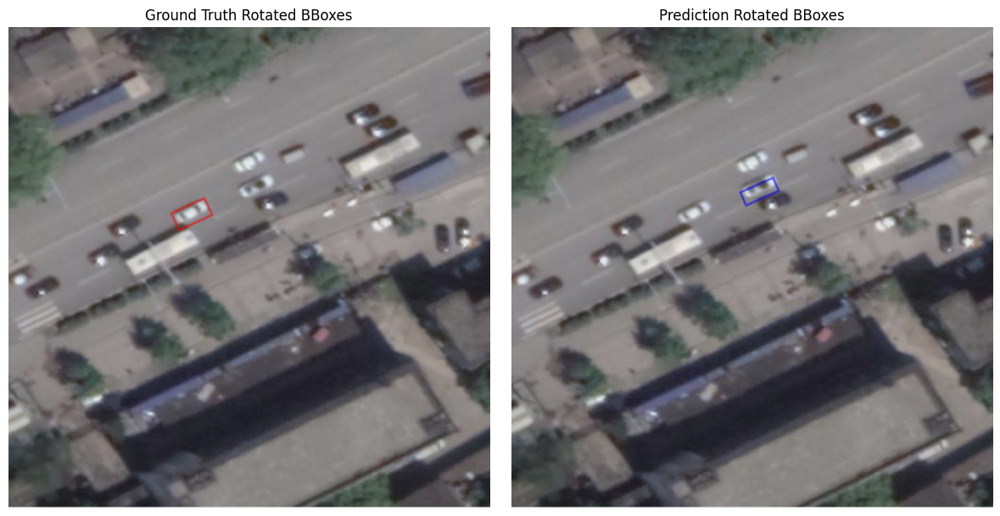

  0%|                                                                                                                                                                                                                                           | 2/11174 [00:00<22:02,  8.45it/s]


Image ID: 0873__512__412___4120.png
Question: [reasoning]Assist me in locating the position of all the objects <rel>adjacent</rel> the object in <rbox>({<8.79><31.15><3.33><6.46>|<86>})</rbox>.
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


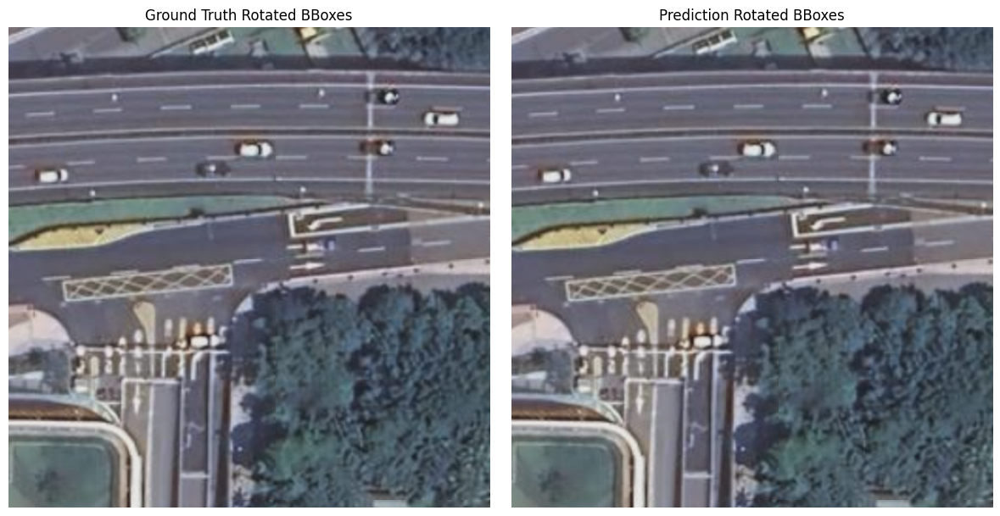

  0%|                                                                                                                                                                                                                                           | 5/11174 [00:00<17:14, 10.80it/s]


Image ID: 0842__512__5356___4120.png
Question: [reasoning]Output the positions of all objects that have a relationship of <rel>driving in the same direction with</rel> with the object present at <rbox>({<59.11><34.00><6.28><2.88>|<28>})</rbox>.
Answer: There is 1 object in total. All categories and coordinates: 1 car<rbox>({<50.10><28.81><6.41><2.65>|<32>})</rbox>.
Ground Truth: There are 2 objects in total. All coordinates: <rbox>({<62.50><27.54><8.07><3.06>|<25>}, {<57.03><29.00><6.28><2.62>|<28>})</rbox>.
2 gt boxes; 1 prediction boxes


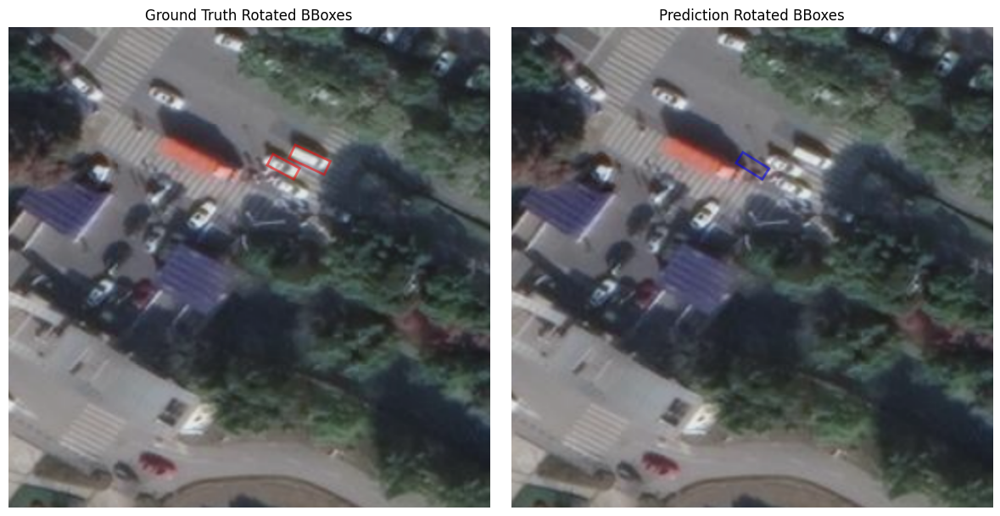

  0%|▏                                                                                                                                                                                                                                          | 8/11174 [00:00<20:18,  9.16it/s]


Image ID: 0873__512__2472___0.png
Question: [reasoning]Point out the cars that are <rel>parked alongside with</rel> the car in the image. Where can I find them?
Answer: There are 2 cars in total. All coordinates: <rbox>({<2.83><85.16><7.03><3.91>|<90>}, {<9.47><91.99><7.12><3.12>|<88>})</rbox>.
Ground Truth: There are 8 cars in total. All coordinates: <rbox>({<3.91><91.70><2.35><7.65>|<85>}, {<11.82><90.72><2.35><7.60>|<82>}, {<4.39><84.08><6.60><3.15>|<81>}, {<8.48><74.42><3.15><6.88>|<83>}, {<8.20><71.09><2.61><6.22>|<77>}, {<6.54><68.36><2.73><6.84>|<90>}, {<5.47><64.36><2.84><6.50>|<74>}, {<4.41><61.00><2.80><6.82>|<77>})</rbox>.
8 gt boxes; 2 prediction boxes


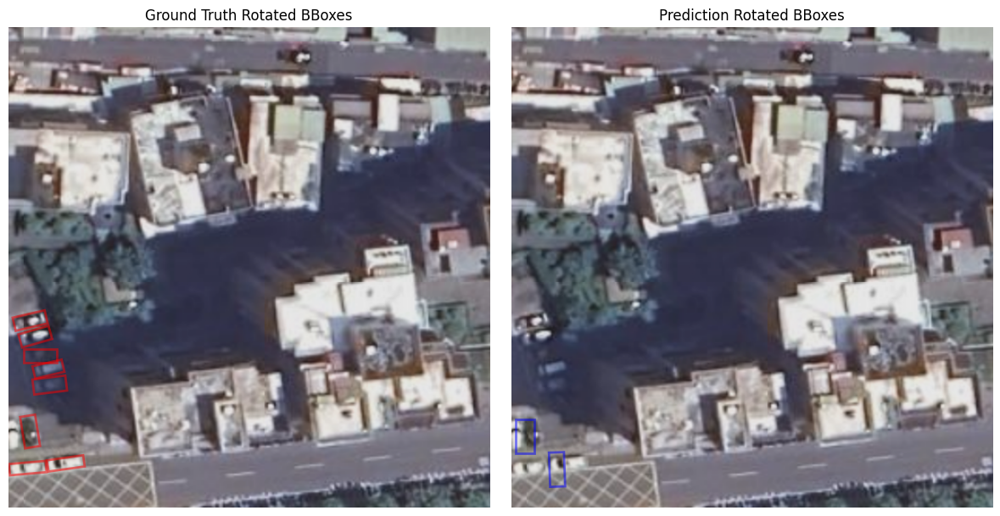

  0%|▏                                                                                                                                                                                                                                          | 9/11174 [00:01<25:29,  7.30it/s]


Image ID: 0041__512__824___824.png
Question: [reasoning]Could you help me find all the objects that have a relationship of <rel>docked alongside with</rel> with the object in <rbox>({<7.62><96.97><7.35><1.66>|<46>})</rbox>? Please provide their locations and categories.
Answer: There is 1 object in total. All categories and coordinates: 1 boat<rbox>({<6.48><97.88><7.04><1.93>|<45>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>boat</ref><rbox>({<6.56><98.17><7.74><1.66>|<47>})</rbox>.
1 gt boxes; 1 prediction boxes


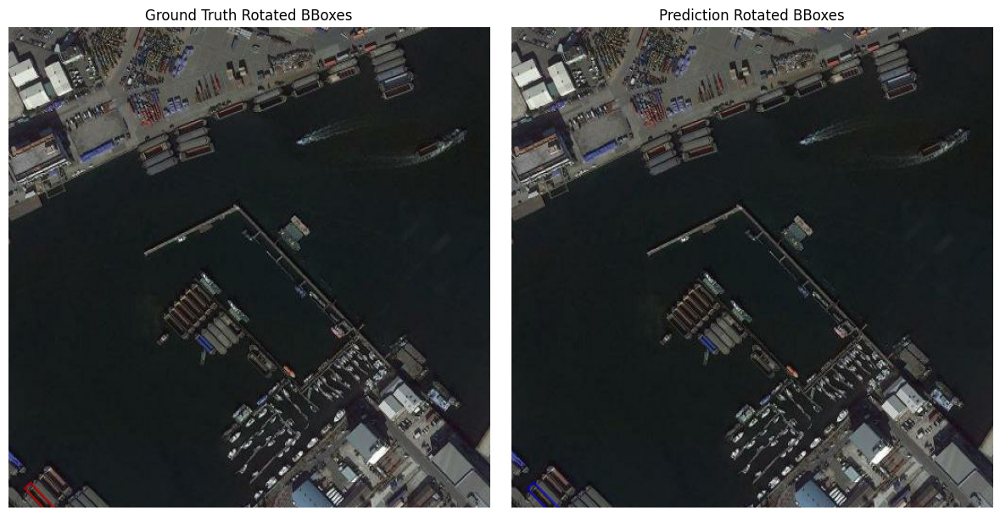

  0%|▍                                                                                                                                                                                                                                         | 20/11174 [00:01<09:11, 20.22it/s]


Image ID: 0977__512__2060___4532.png
Question: [reasoning]What objects have the relationship of <rel>parked alongside with</rel> with the <ref>car</ref> present at <rbox>({<95.70><69.63><6.09><3.32>|<60>})</rbox>? Could you locate and classify them for me?
Answer: There is 1 object in total. All categories and coordinates: 1 car<rbox>({<83.01><74.61><6.64><3.32>|<61>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>car</ref><rbox>({<82.21><74.94><6.45><2.93>|<53>})</rbox>.
1 gt boxes; 1 prediction boxes


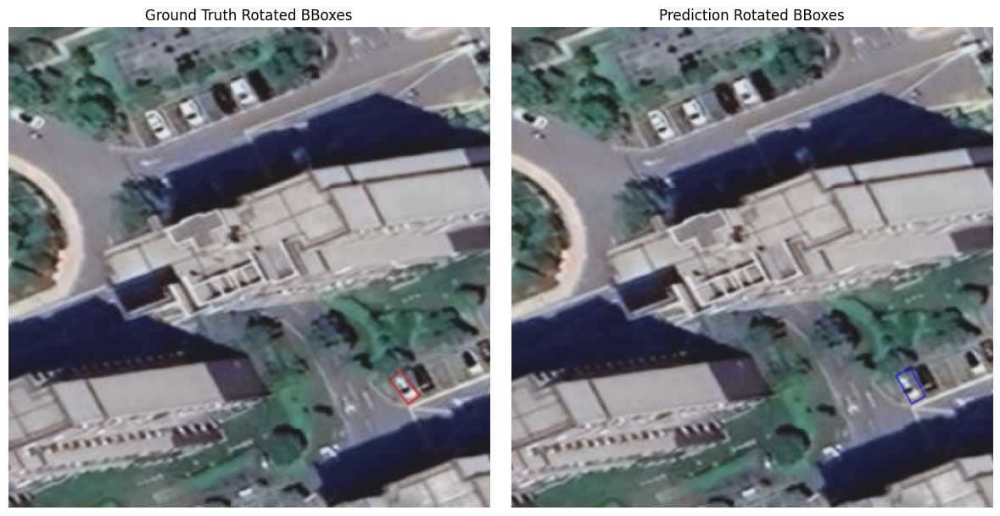

  0%|▍                                                                                                                                                                                                                                         | 23/11174 [00:01<11:23, 16.31it/s]


Image ID: 0021__512__2884___2884.png
Question: [reasoning]Detect all the objects that have a relationship <rel>connect</rel> with the <ref>boarding_bridge</ref> in <rbox>({<10.09><21.21><8.41><9.28>|<30>})</rbox> and output their locations.
Answer: There is 1 object in total. All categories and coordinates: 1 airplane<rbox>({<11.28><30.81><12.99><11.47>|<47>})</rbox>.
Ground Truth: There is 1 object in total. All coordinates: <rbox>({<10.44><30.13><14.64><15.71>|<30>})</rbox>.
1 gt boxes; 1 prediction boxes


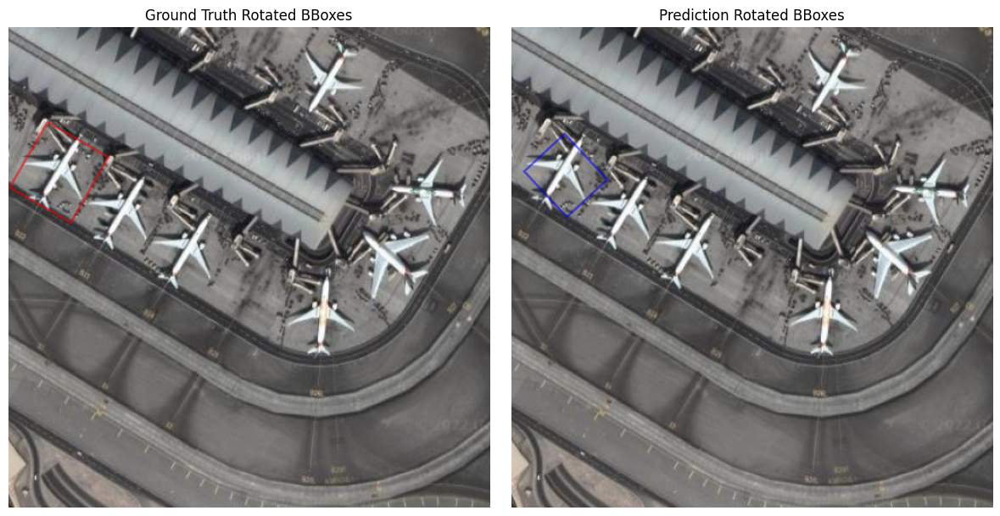

  0%|▌                                                                                                                                                                                                                                         | 25/11174 [00:01<13:44, 13.52it/s]


Image ID: 0739__512__6180___3708.png
Question: [reasoning]Please locate all the ships that are <rel>parallelly docked at</rel> the dock and provide their coordinates.
Answer: There are 2 ships in total. All coordinates: <rbox>({<62.50><37.21><4.69><15.05>|<2>}, {<89.55><27.95><2.35><10.37>|<3>})</rbox>.
Ground Truth: There are 6 ships in total. All coordinates: <rbox>({<61.52><65.62><2.99><12.56>|<9>}, {<58.30><65.14><3.56><12.34>|<10>}, {<55.27><66.02><2.18><10.33>|<9>}, {<52.34><67.38><2.99><10.18>|<10>}, {<48.84><69.86><2.76><8.35>|<10>}, {<47.75><60.64><10.39><2.80>|<78>})</rbox>.
6 gt boxes; 2 prediction boxes


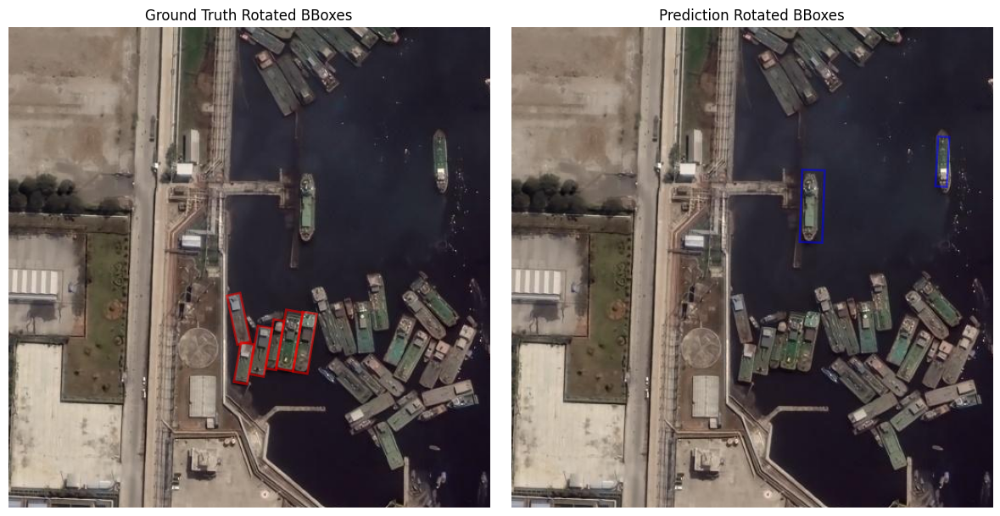


Image ID: 1256__512__3296___1236.png
Question: [reasoning]Point out the objects that are <rel>indirectly transmit electricity to</rel> the intersection in the image. Where can I find them?
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


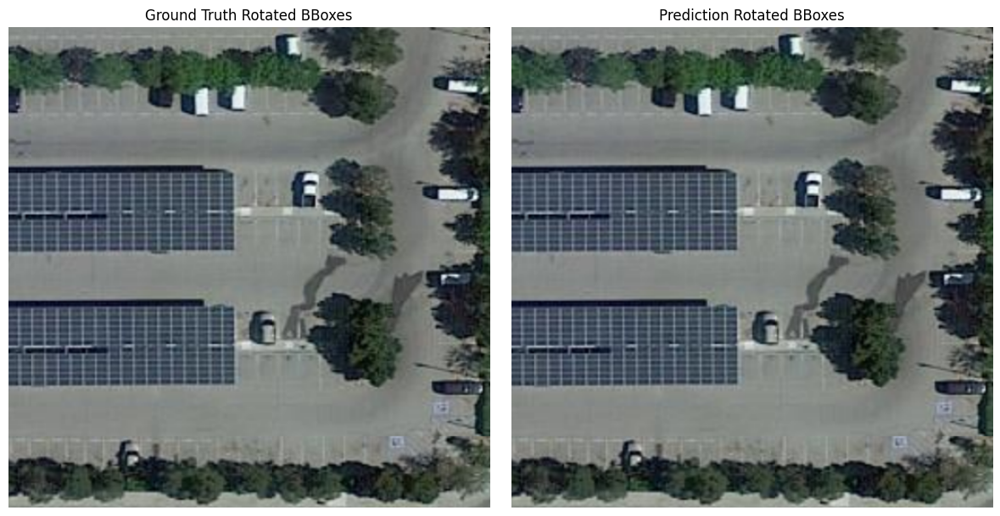

  0%|▌                                                                                                                                                                                                                                         | 27/11174 [00:02<21:00,  8.84it/s]


Image ID: 0018__512__2060___2884.png
Question: [reasoning]Identify and provide the coordinates of all objects that are <rel>pass through</rel> the <ref>boarding_bridge</ref> present at <rbox>({<97.44><34.99><4.72><3.66>|<60>})</rbox> in the image.
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


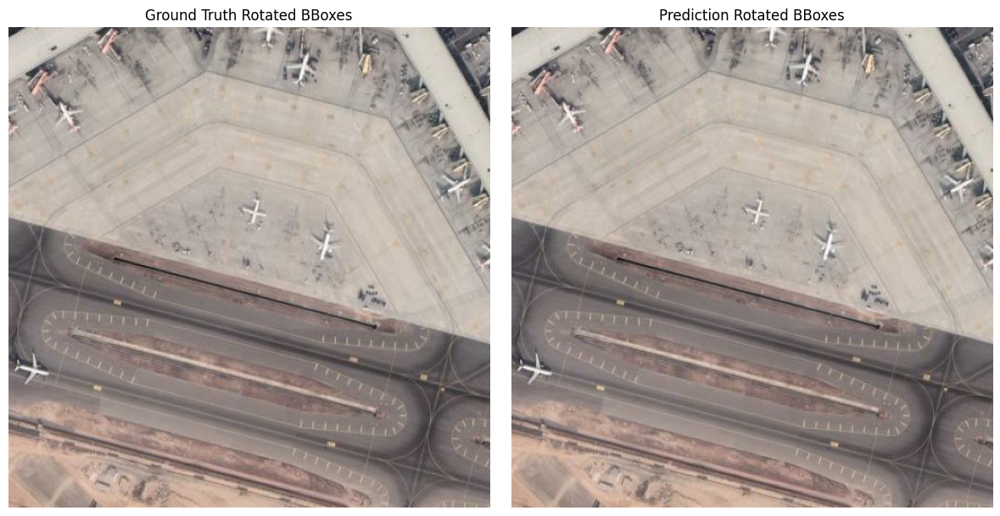

  0%|▋                                                                                                                                                                                                                                         | 33/11174 [00:02<14:33, 12.76it/s]


Image ID: 0873__512__6592___3708.png
Question: [reasoning]Your task is to locate all objects that have a relationship <rel>within safe distance of</rel> with object in location <rbox>({<1.42><42.21><3.59><7.27>|<60>})</rbox> and classify them.
Answer: There is 1 object in total. All categories and coordinates: 1 car<rbox>({<40.53><63.38><3.63><7.85>|<36>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>car</ref><rbox>({<37.01><19.34><3.36><6.94>|<55>})</rbox>.
1 gt boxes; 1 prediction boxes


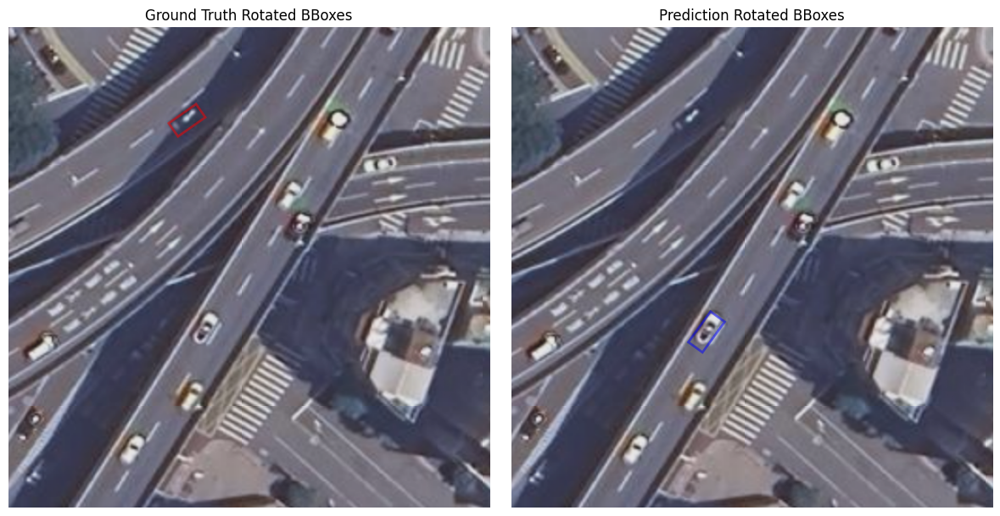

  0%|▋                                                                                                                                                                                                                                         | 35/11174 [00:02<16:00, 11.60it/s]


Image ID: 1255__512__9456___11124.png
Question: [reasoning]Assist me in locating the position of all the objects <rel>working on</rel> the <ref>car</ref> in <rbox>({<80.37><63.87><7.45><2.71>|<32>})</rbox>.
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


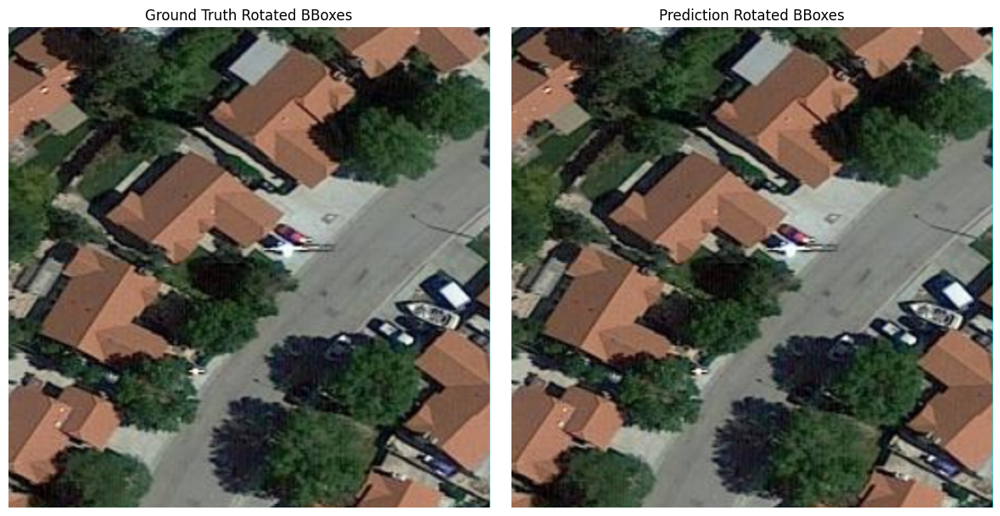

  0%|▊                                                                                                                                                                                                                                         | 37/11174 [00:03<17:43, 10.47it/s]


Image ID: 0862__512__15656___4532.png
Question: [reasoning]Find the objects that have a relationship of <rel>driving in the same lane with</rel> with the unfinished_building. Can you give me their positions and categories?
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


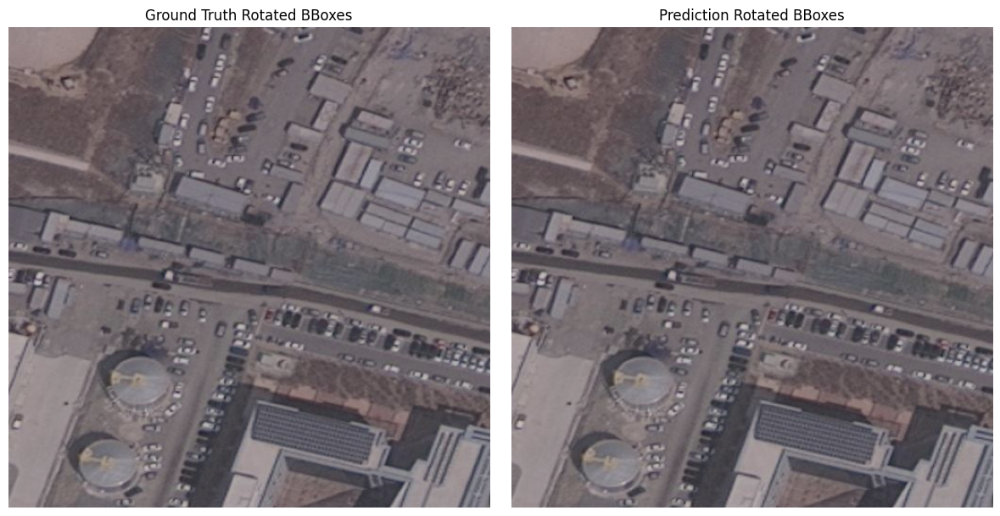

  0%|▉                                                                                                                                                                                                                                         | 42/11174 [00:03<14:11, 13.08it/s]


Image ID: 0825__512__3708___3296.png
Question: [reasoning]Please locate all the objects that are <rel>parked alongside with</rel> the <ref>car</ref> present at <rbox>({<94.04><93.95><7.40><3.56>|<82>})</rbox> and provide their positions.
Answer: There is 1 object in total. All categories and coordinates: 1 car<rbox>({<90.43><94.04><7.16><3.76>|<80>})</rbox>.
Ground Truth: There is 1 object in total. All coordinates: <rbox>({<90.14><94.63><5.66><4.10>|<90>})</rbox>.
1 gt boxes; 1 prediction boxes


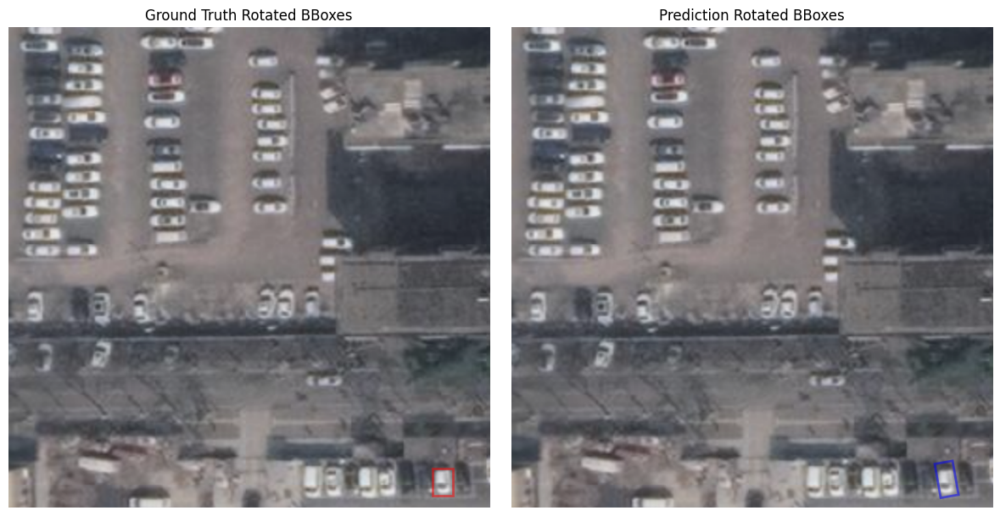

  0%|▉                                                                                                                                                                                                                                         | 44/11174 [00:03<15:43, 11.80it/s]


Image ID: 0824__512__4944___3708.png
Question: [reasoning]Find the objects that have a relationship of <rel>driving in the opposite direction with</rel> with the car. Can you give me their positions and categories?
Answer: There is 1 object in total. All categories and coordinates: 1 car<rbox>({<67.09><39.55><3.25><7.03>|<59>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>car</ref><rbox>({<69.82><48.83><2.96><6.93>|<81>})</rbox>.
1 gt boxes; 1 prediction boxes


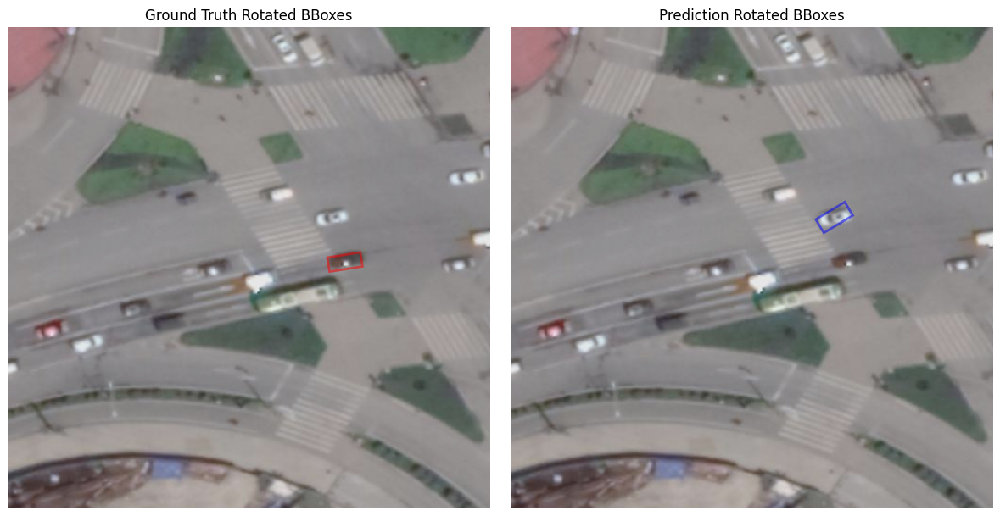

  0%|▉                                                                                                                                                                                                                                         | 46/11174 [00:03<16:47, 11.05it/s]


Image ID: 0031__512__412___824.png
Question: [reasoning]Point out the ships that are <rel>docking at the same dock with</rel> the <ref>ship</ref> in location <rbox>({<65.53><27.13><1.32><7.78>|<28>})</rbox> in the image. Where can I find them?
Answer: There is 1 ship in total. All coordinates: <rbox>({<66.21><28.71><1.84><8.99>|<34>})</rbox>.
Ground Truth: There is 1 ship in total. All coordinates: <rbox>({<63.41><25.92><3.32><7.70>|<30>})</rbox>.
1 gt boxes; 1 prediction boxes


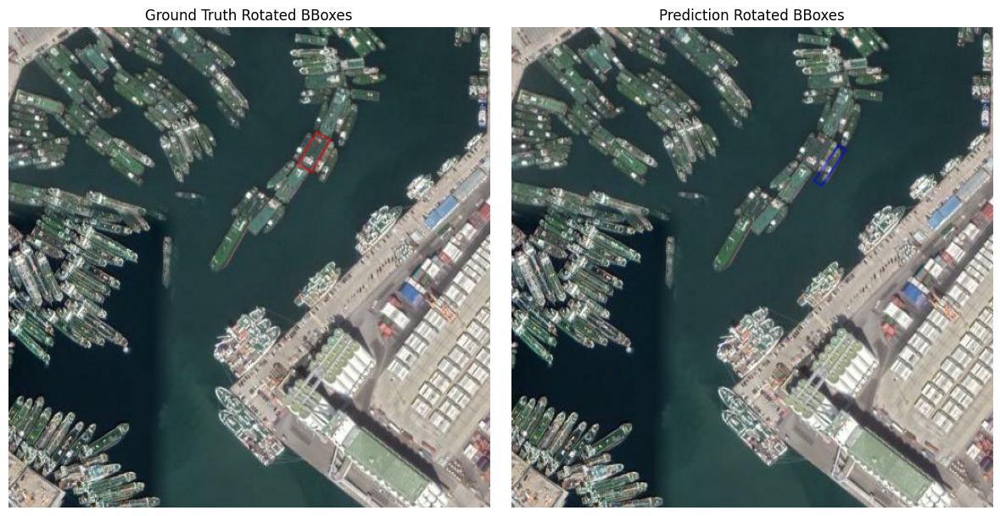

  0%|█                                                                                                                                                                                                                                         | 50/11174 [00:04<14:21, 12.91it/s]


Image ID: 0865__512__9064___21012.png
Question: [reasoning]Find all the objects that have a relationship of <rel>running along the different runway with</rel> with the object present at <rbox>({<72.53><10.29><25.56><14.61>|<30>})</rbox>. Can you give me their positions and categories?
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


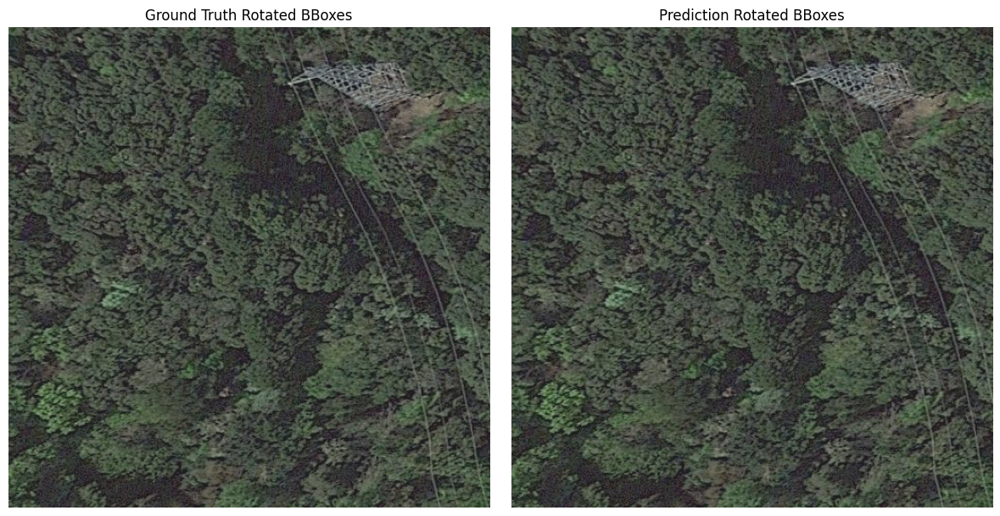


Image ID: 0230__512__412___2884.png
Question: [reasoning]There are some objects that are <rel>directly connected to</rel> the object present at <rbox>({<85.92><20.59><8.34><7.91>|<32>})</rbox>. Could you tell me their locations?
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


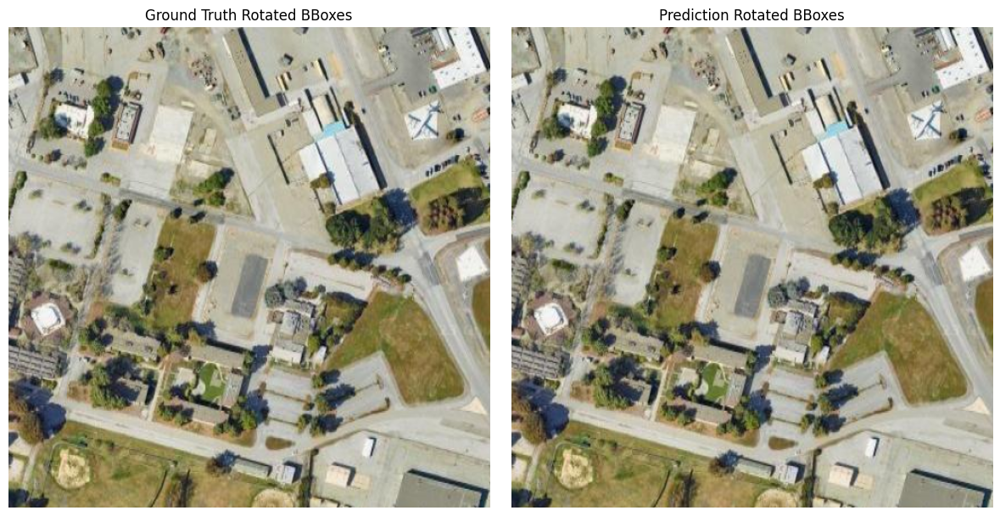

  0%|█                                                                                                                                                                                                                                         | 52/11174 [00:04<22:06,  8.39it/s]


Image ID: 1255__512__8240___9476.png
Question: [reasoning]Identify and provide the coordinates of all objects that are <rel>driving in the same direction with</rel> the object present at <rbox>({<3.81><10.35><6.64><3.71>|<90>})</rbox> in the image.
Answer: There is 1 object in total. All categories and coordinates: 1 car<rbox>({<62.89><5.96><3.71><11.13>|<90>})</rbox>.
Ground Truth: There is 1 object in total. All coordinates: <rbox>({<3.61><96.97><9.41><4.11>|<87>})</rbox>.
1 gt boxes; 1 prediction boxes


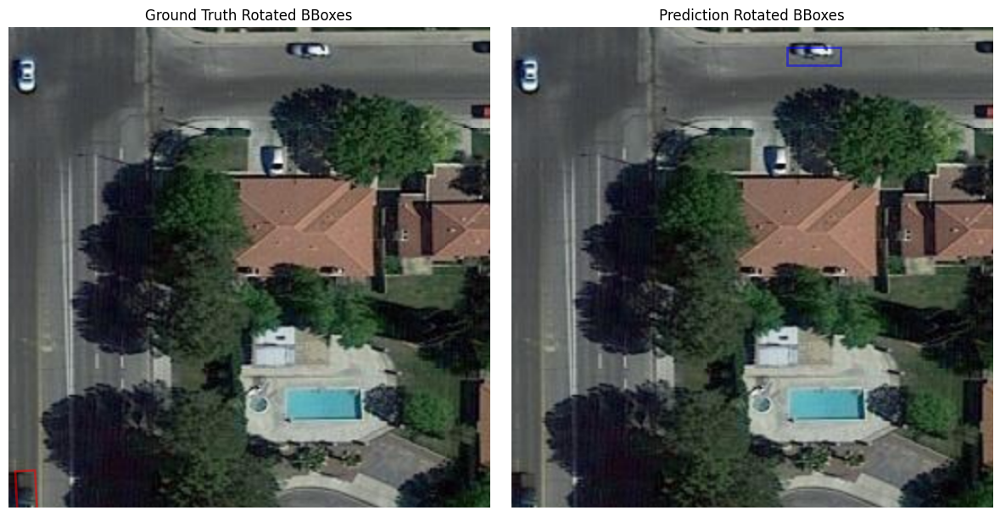

  1%|█▏                                                                                                                                                                                                                                        | 56/11174 [00:04<17:56, 10.33it/s]


Image ID: 0701__512__824___0.png
Question: [reasoning]Please locate and categorize all the objects that are <rel>docked alongside with</rel> the <ref>boat</ref> in location <rbox>({<1.15><83.67><4.18><1.52>|<37>})</rbox>.
Answer: There is 1 object in total. All categories and coordinates: 1 boat<rbox>({<1.37><82.42><4.19><1.52>|<41>})</rbox>.
Ground Truth: There are 2 objects in total. All categories and coordinates: 2 <ref>boats</ref><rbox>({<0.49><85.35><5.33><1.80>|<38>}, {<2.00><81.98><6.35><1.80>|<45>})</rbox>.
2 gt boxes; 1 prediction boxes


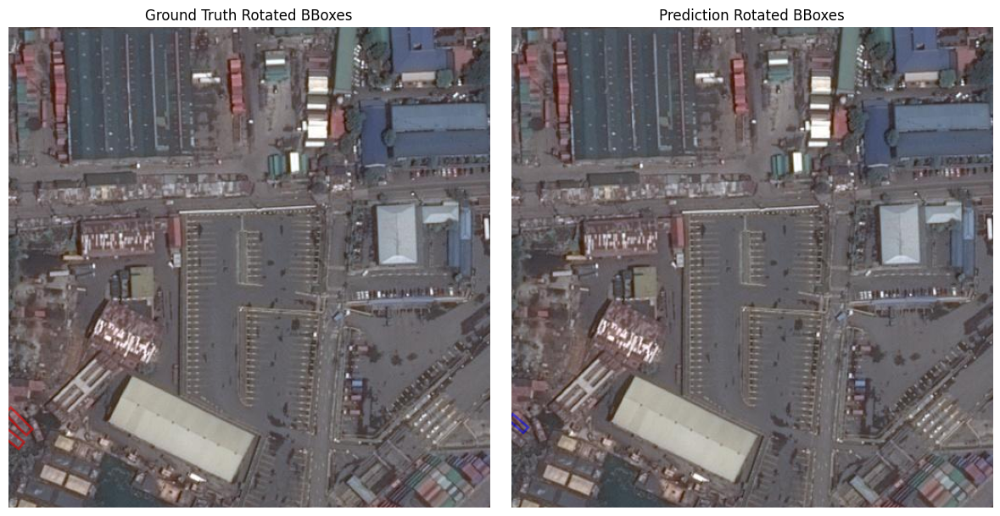

  1%|█▎                                                                                                                                                                                                                                        | 60/11174 [00:05<15:48, 11.72it/s]


Image ID: 1255__512__2060___1648.png
Question: [reasoning]Find all the objects that have a relationship of <rel>parked alongside with</rel> with the object present at <rbox>({<77.54><18.16><2.73><7.42>|<90>})</rbox>. Can you give me their positions and categories?
Answer: There is 1 object in total. All categories and coordinates: 1 car<rbox>({<86.52><18.16><2.93><8.20>|<90>})</rbox>.
Ground Truth: There are 2 objects in total. All categories and coordinates: 2 <ref>cars</ref><rbox>({<44.92><16.60><8.71><2.96>|<6>}, {<86.23><18.26><2.73><8.85>|<88>})</rbox>.
2 gt boxes; 1 prediction boxes


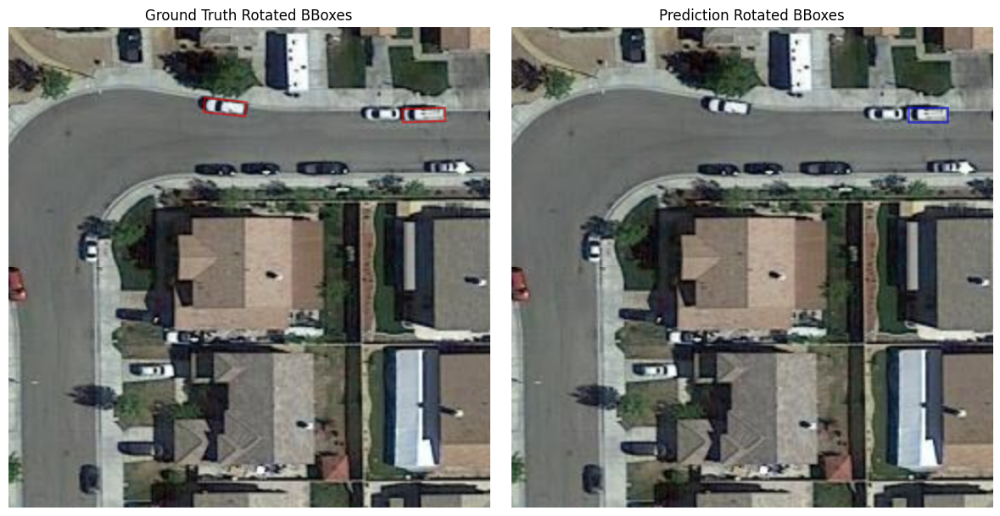

  1%|█▍                                                                                                                                                                                                                                        | 66/11174 [00:05<12:12, 15.16it/s]


Image ID: 0825__512__4944___3296.png
Question: [reasoning]Please find and classify all objects that has a relationship <rel>driving in the same lane with</rel> with object in <rbox>({<15.92><69.53><7.03><4.10>|<90>})</rbox>.
Answer: There is 1 object in total. All categories and coordinates: 1 car<rbox>({<15.43><61.09><3.52><6.45>|<1>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>car</ref><rbox>({<15.53><61.13><7.42><4.10>|<90>})</rbox>.
1 gt boxes; 1 prediction boxes


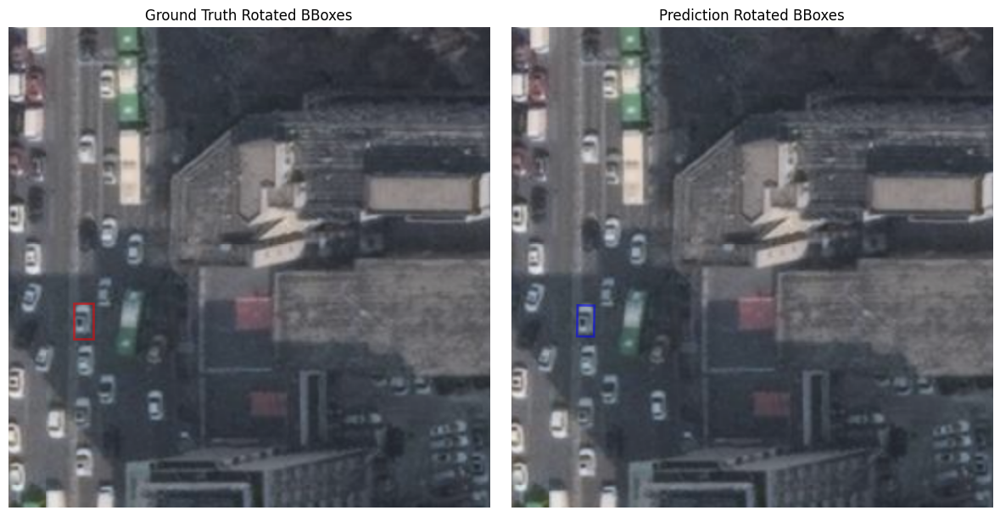

  1%|█▍                                                                                                                                                                                                                                        | 69/11174 [00:05<12:45, 14.51it/s]


Image ID: 0248__512__3708___2060.png
Question: [reasoning]Assist me in locating the position of all the boats <rel>docking at the same dock with</rel> the <ref>boat</ref> in <rbox>({<93.85><85.74><6.91><2.50>|<53>})</rbox>.
Answer: There is 1 boat in total. All coordinates: <rbox>({<91.70><87.60><7.26><2.44>|<66>})</rbox>.
Ground Truth: There is 1 boat in total. All coordinates: <rbox>({<92.67><86.80><7.38><2.93>|<52>})</rbox>.
1 gt boxes; 1 prediction boxes


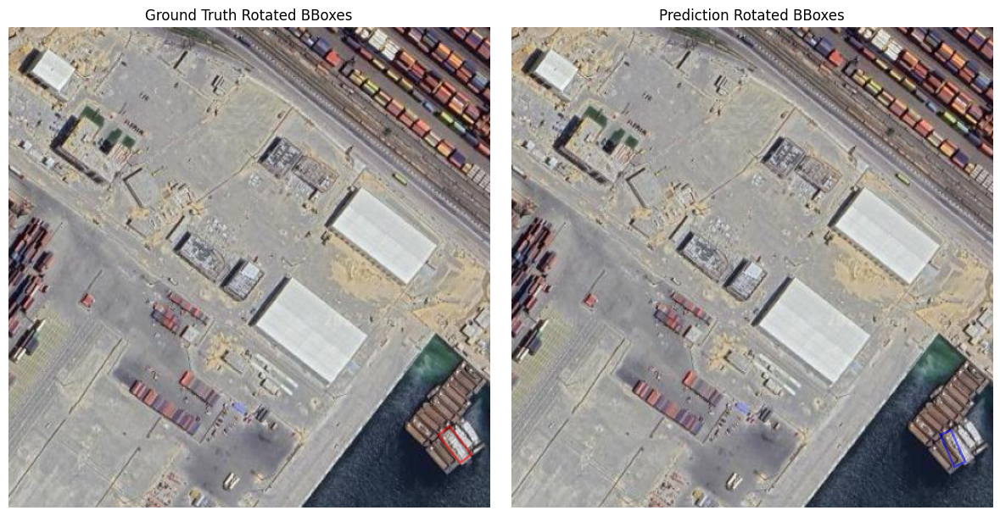

  1%|█▍                                                                                                                                                                                                                                        | 71/11174 [00:05<14:45, 12.53it/s]


Image ID: 0745__512__5356___2472.png
Question: [reasoning]Provide the coordinates and categories of all objects that are <rel>not docked alongside with</rel> the ship in the image.
Answer: There are 2 objects in total. All categories and coordinates: 2 ships<rbox>({<81.84><83.20><4.18><10.54>|<37>}, {<72.46><92.29><2.93><10.41>|<54>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>boat</ref><rbox>({<74.71><93.36><1.65><7.24>|<39>})</rbox>.
1 gt boxes; 2 prediction boxes


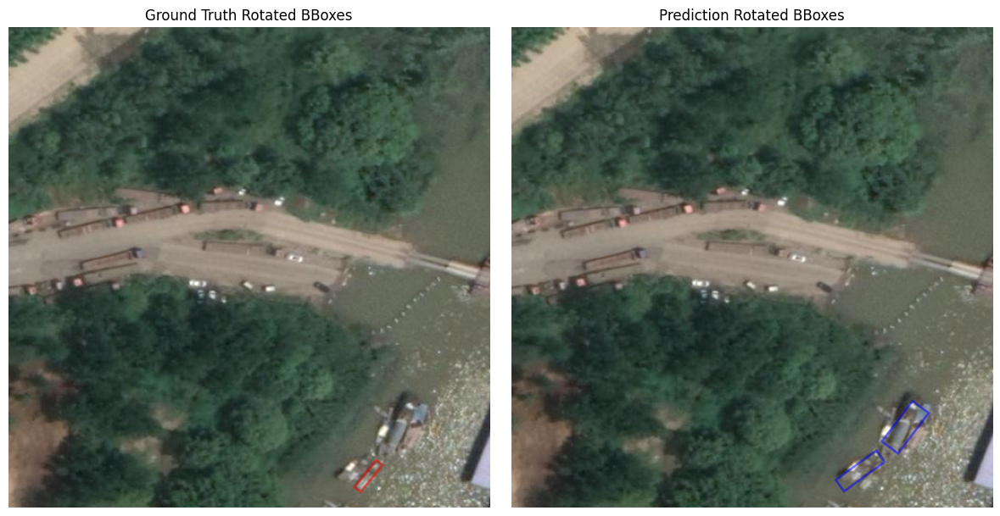

  1%|█▌                                                                                                                                                                                                                                        | 73/11174 [00:06<16:13, 11.40it/s]


Image ID: 0704__512__3296___2884.png
Question: [reasoning]Identify and provide the coordinates of all boats that are <rel>docked alongside with</rel> the object present at <rbox>({<17.04><5.91><6.49><1.93>|<45>})</rbox> in the image.
Answer: There is 1 boat in total. All coordinates: <rbox>({<18.55><7.42><7.01><1.80>|<40>})</rbox>.
Ground Truth: There is 1 boat in total. All coordinates: <rbox>({<18.75><5.08><6.35><1.93>|<45>})</rbox>.
1 gt boxes; 1 prediction boxes


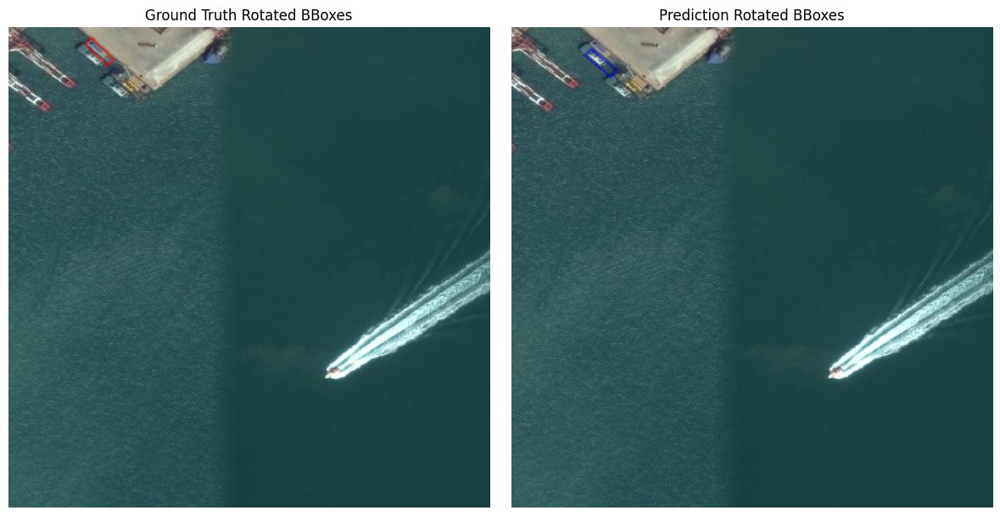

  1%|█▋                                                                                                                                                                                                                                        | 79/11174 [00:06<11:25, 16.19it/s]


Image ID: 0740__512__2472___3708.png
Question: [reasoning]Provide the coordinates and categories of all objects that are <rel>docked alongside with</rel> the ship in the image.
Answer: There is 1 object in total. All categories and coordinates: 1 boat<rbox>({<29.59><20.80><1.38><3.98>|<78>})</rbox>.
Ground Truth: There are 2 objects in total. All categories and coordinates: 2 <ref>ships</ref><rbox>({<21.01><63.12><16.37><3.71>|<72>}, {<25.99><64.09><16.80><4.08>|<72>})</rbox>.
2 gt boxes; 1 prediction boxes


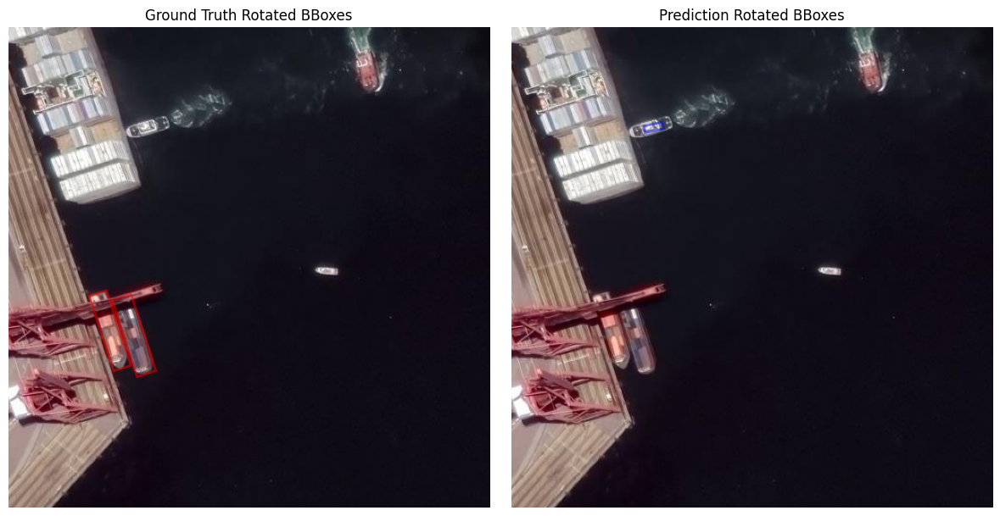

  1%|█▋                                                                                                                                                                                                                                        | 82/11174 [00:06<11:23, 16.22it/s]


Image ID: 0827__512__1236___4120.png
Question: [reasoning]Identify and provide the coordinates of all cars that are <rel>driving in the same direction with</rel> the car in the image.
Answer: There are 2 cars in total. All coordinates: <rbox>({<59.38><80.18><6.52><2.74>|<5>}, {<59.38><87.01><6.52><2.74>|<5>})</rbox>.
Ground Truth: There are 4 cars in total. All coordinates: <rbox>({<62.89><99.32><6.57><3.59>|<46>}, {<57.91><94.04><7.18><3.59>|<45>}, {<57.76><85.21><9.12><3.73>|<45>}, {<60.64><81.74><7.73><3.59>|<45>})</rbox>.
4 gt boxes; 2 prediction boxes


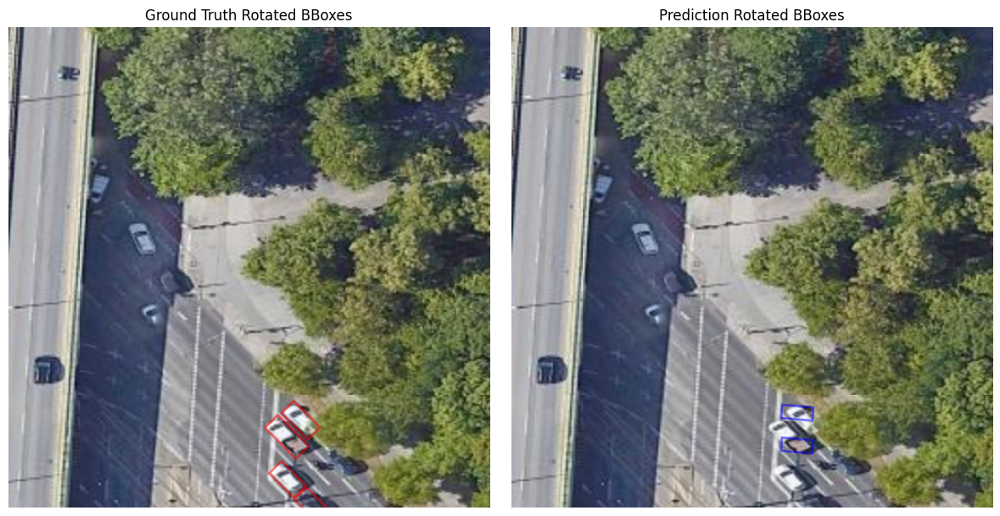


Image ID: 0027__512__1648___2472.png
Question: [reasoning]What objects have the relationship of <rel>over</rel> with the <ref>dock</ref> present at <rbox>({<66.81><79.43><53.29><101.62>|<5>})</rbox>? Could you locate and classify them for me?
Answer: There are 3 objects in total. All categories and coordinates: 3 cranes<rbox>({<40.52><62.41><5.86><12.98>|<53>}, {<43.91><56.56><5.74><12.55>|<53>}, {<37.98><45.90><5.86><12.55>|<53>})</rbox>.
Ground Truth: There are 3 objects in total. All categories and coordinates: 3 <ref>cranes</ref><rbox>({<45.02><60.94><2.62><12.33>|<61>}, {<49.22><62.99><3.49><7.42>|<63>}, {<68.16><97.95><3.23><8.41>|<61>})</rbox>.
3 gt boxes; 3 prediction boxes


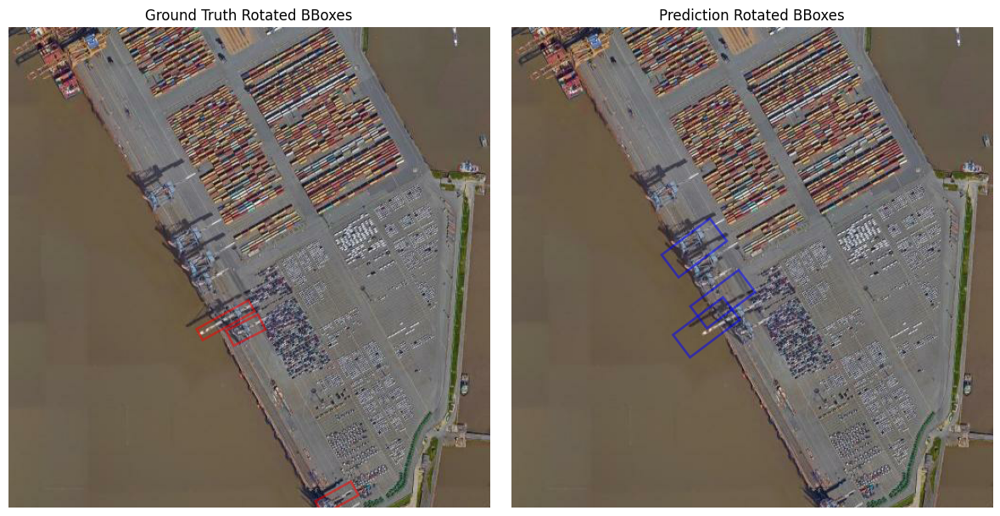

  1%|█▊                                                                                                                                                                                                                                        | 84/11174 [00:07<20:04,  9.21it/s]


Image ID: 0989__512__2472___1648.png
Question: [reasoning]Can you help me locate all the objects that are <rel>within danger distance of</rel> the car and give me their positions?
Answer: There are 2 objects in total. All categories and coordinates: 2 cars<rbox>({<48.93><26.37><3.34><6.69>|<6>}, {<46.97><36.38><3.34><6.66>|<6>})</rbox>.
Ground Truth: There are 2 objects in total. All coordinates: <rbox>({<58.69><19.63><4.30><6.96>|<1>}, {<56.15><30.53><7.42><4.30>|<88>})</rbox>.
2 gt boxes; 2 prediction boxes


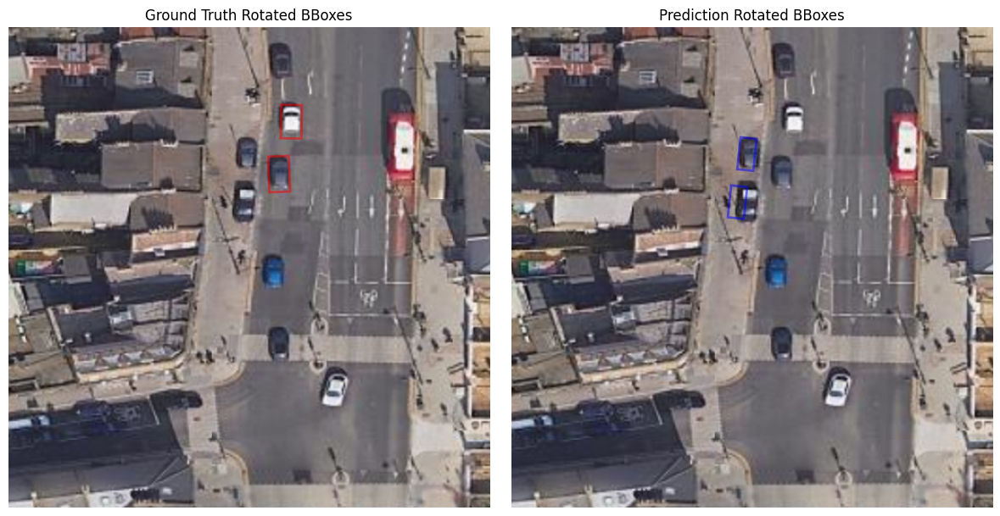

  1%|█▊                                                                                                                                                                                                                                        | 88/11174 [00:07<16:48, 11.00it/s]


Image ID: 0873__512__4944___4120.png
Question: [reasoning]Please locate all the objects that are <rel>indirectly connected to</rel> the gas_station and provide their positions.
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


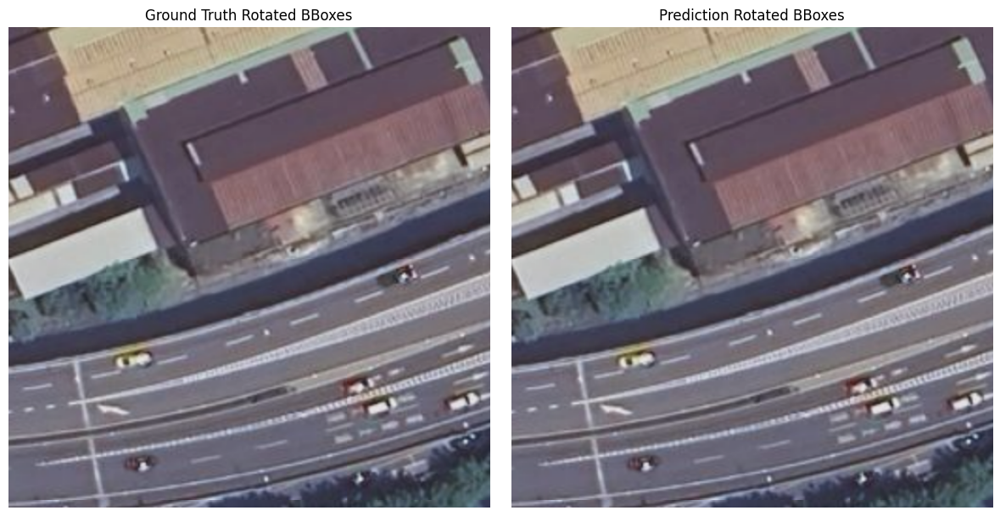

  1%|█▉                                                                                                                                                                                                                                        | 91/11174 [00:07<16:04, 11.49it/s]


Image ID: 0214__512__2060___3708.png
Question: [reasoning]I need you to locate and categorize all objects that have a relationship <rel>parking in the different apron with</rel> with airplane.
Answer: There is 1 object in total. All categories and coordinates: 1 airplane<rbox>({<48.34><65.14><7.91><7.54>|<75>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>airplane</ref><rbox>({<47.67><64.51><5.99><5.19>|<19>})</rbox>.
1 gt boxes; 1 prediction boxes


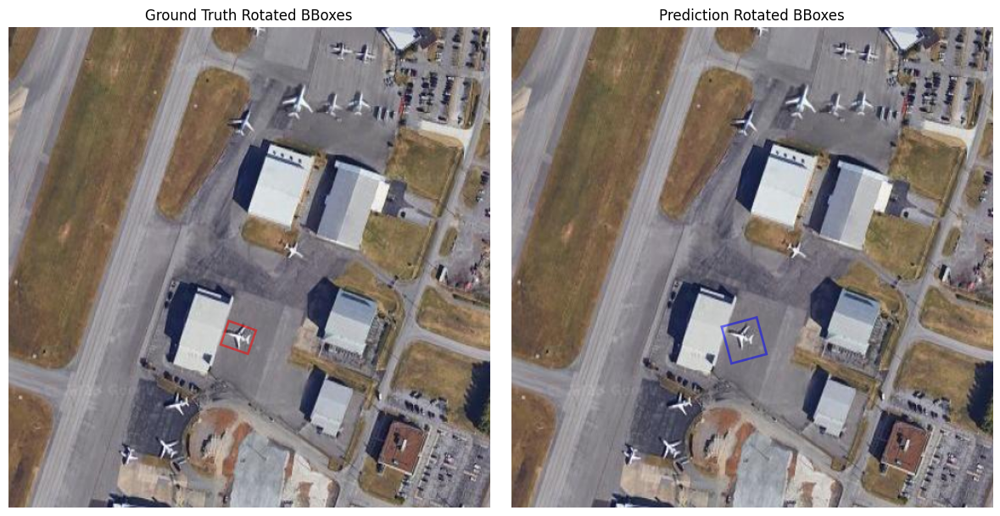

  1%|█▉                                                                                                                                                                                                                                        | 93/11174 [00:07<17:32, 10.53it/s]


Image ID: 0739__512__2472___4532.png
Question: [reasoning]I need you to locate and categorize all objects that have a relationship <rel>docking at the same dock with</rel> with object in location <rbox>({<19.53><78.52><2.73><4.69>|<90>})</rbox>.
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


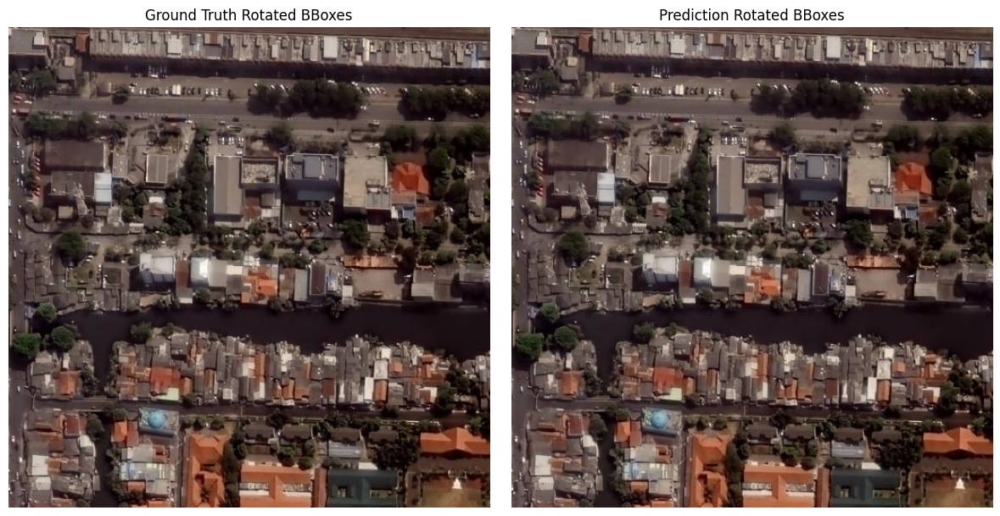

  1%|██                                                                                                                                                                                                                                        | 97/11174 [00:08<15:13, 12.12it/s]


Image ID: 0067__512__4532___3708.png
Question: [reasoning]Find the objects that have a relationship of <rel>adjacent</rel> with the <ref>terminal</ref> in <rbox>({<75.29><37.11><51.26><10.08>|<55>})</rbox>. Where are they situated?
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: There is 1 object in total. All coordinates: <rbox>({<44.31><68.08><74.70><75.68>|<56>})</rbox>.
1 gt boxes; 0 prediction boxes


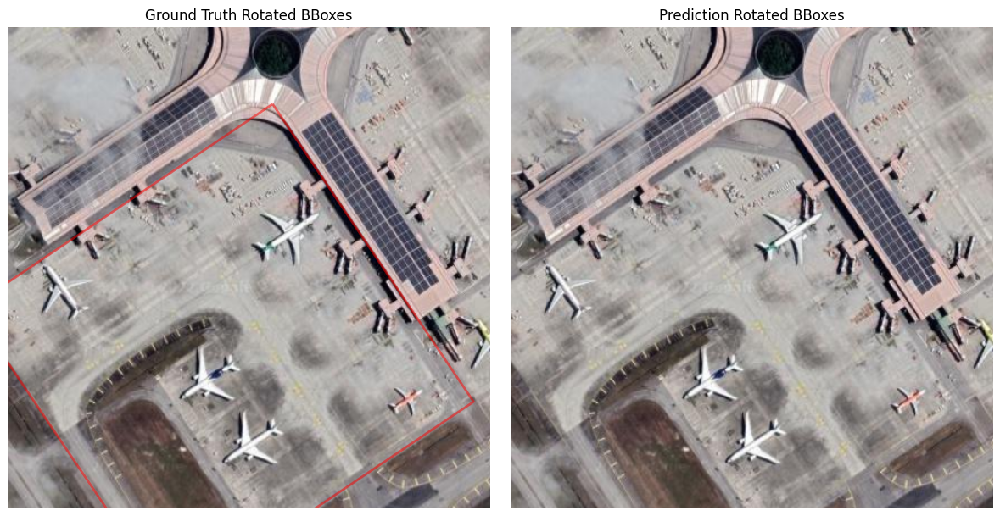

  1%|██▏                                                                                                                                                                                                                                      | 103/11174 [00:08<11:44, 15.73it/s]


Image ID: 0873__512__5768___4944.png
Question: [reasoning]I need you to locate all the cars that are <rel>driving in the same direction with</rel> the car. Can you assist me with this task?
Answer: There are 4 cars in total. All coordinates: <rbox>({<68.75><35.55><3.06><6.33>|<25>}, {<61.35><46.41><3.41><6.91>|<28>}, {<54.38><54.76><3.41><6.91>|<28>}, {<49.32><51.76><3.23><5.13>|<23>})</rbox>.
Ground Truth: There are 19 cars in total. All coordinates: <rbox>({<80.37><13.67><3.95><7.21>|<32>}, {<73.71><25.03><3.85><7.17>|<29>}, {<66.80><35.55><3.15><7.19>|<29>}, {<61.43><45.70><3.95><6.74>|<31>}, {<54.69><55.47><4.12><7.09>|<30>}, {<80.47><42.87><3.15><6.52>|<28>}, {<68.26><55.66><3.36><6.69>|<34>}, {<56.22><81.72><3.32><5.50>|<28>}, {<24.51><75.10><3.79><6.16>|<33>}, {<35.38><66.17><3.15><5.96>|<31>}, {<21.39><67.58><3.52><7.63>|<34>}, {<46.58><56.45><3.76><6.53>|<28>})</rbox>, and due to the context length, the remaining objects are not listed.
12 gt boxes; 4 prediction boxes


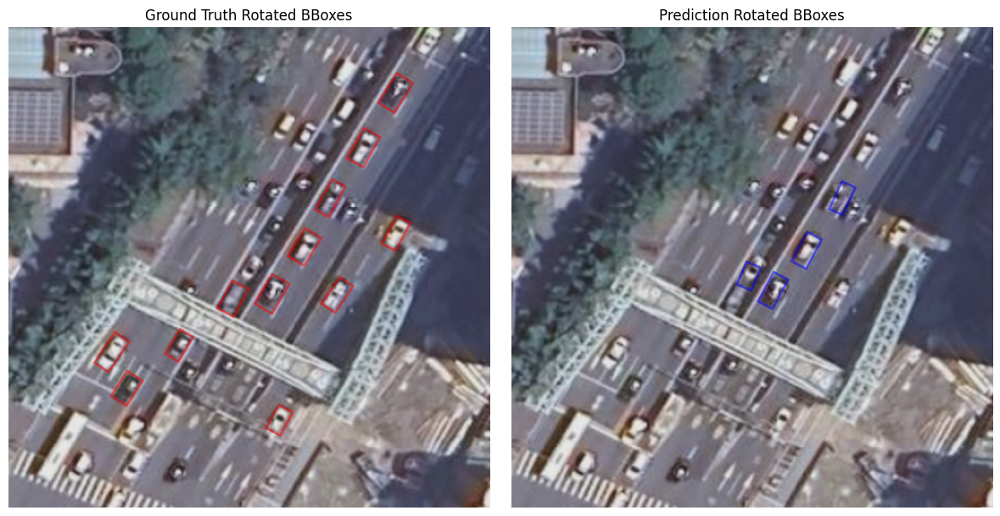

  1%|██▎                                                                                                                                                                                                                                      | 108/11174 [00:08<10:54, 16.91it/s]


Image ID: 0748__512__10712___11124.png
Question: [reasoning]Please locate and classify all the objects that are <rel>randomly docked at</rel> the object present at <rbox>({<17.56><4.86><41.95><40.27>|<52>})</rbox>.
Answer: There are 2 objects in total. All categories and coordinates: 2 ships<rbox>({<15.43><45.31><8.93><2.99>|<79>}, {<18.26><44.53><18.36><4.18>|<79>})</rbox>.
Ground Truth: There are 2 objects in total. All categories and coordinates: 2 <ref>ships</ref><rbox>({<14.65><46.00><31.15><6.49>|<73>}, {<21.09><44.53><30.11><6.55>|<71>})</rbox>.
2 gt boxes; 2 prediction boxes


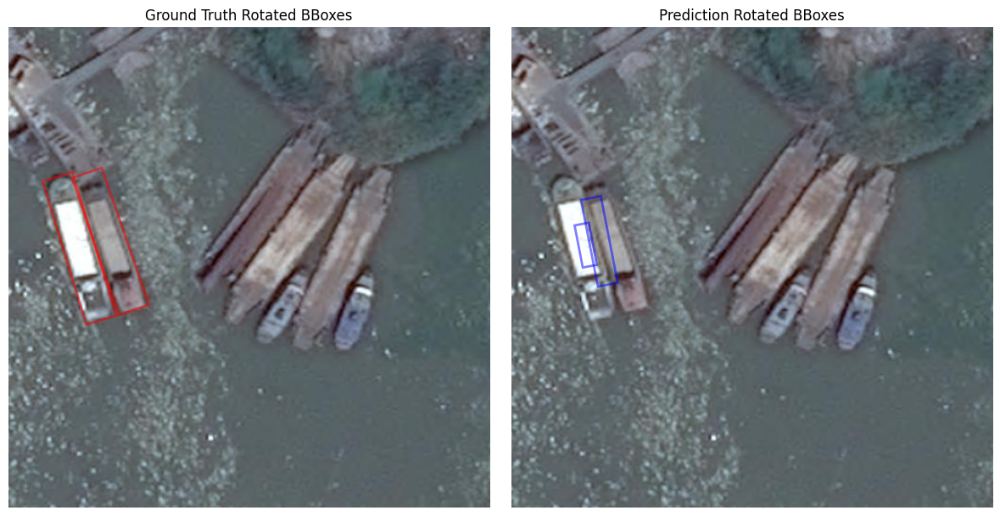

  1%|██▎                                                                                                                                                                                                                                      | 113/11174 [00:08<10:00, 18.43it/s]


Image ID: 0031__512__412___824.png
Question: [reasoning]Find all the boats that have a relationship of <rel>docked alongside with</rel> with the ship. Can you give me their positions?
Answer: There is 1 boat in total. All coordinates: <rbox>({<6.15><17.87><3.49><10.04>|<63>})</rbox>.
Ground Truth: There is 1 boat in total. All coordinates: <rbox>({<56.37><32.59><0.97><3.88>|<40>})</rbox>.
1 gt boxes; 1 prediction boxes


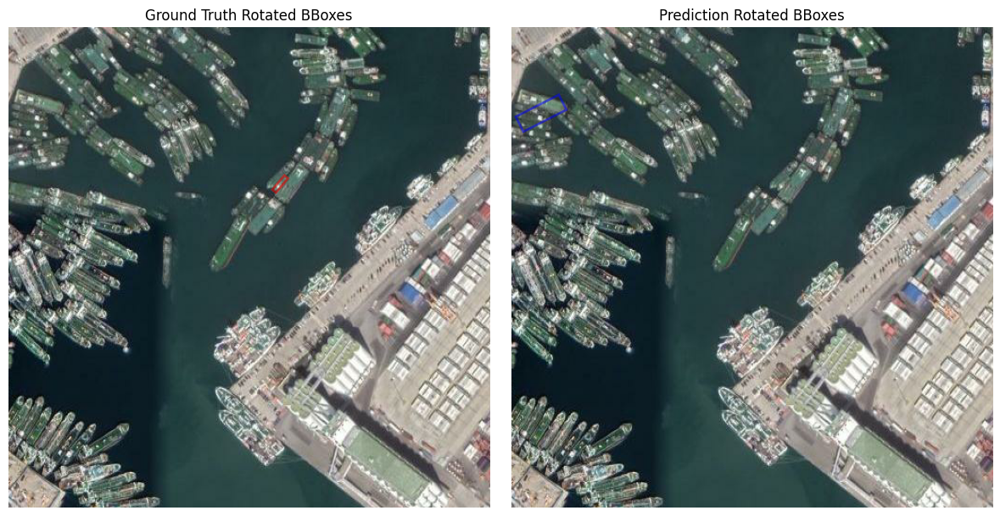

  1%|██▋                                                                                                                                                                                                                                      | 126/11174 [00:09<06:10, 29.86it/s]


Image ID: 0456__512__4944___1648.png
Question: [reasoning]Provide the coordinates and categories of all objects that are <rel>docking at the same dock with</rel> the object present at <rbox>({<15.89><45.71><0.80><2.38>|<80>})</rbox> in the image.
Answer: There is 1 object in total. All categories and coordinates: 1 boat<rbox>({<15.23><45.02><0.78><2.15>|<90>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>boat</ref><rbox>({<15.53><44.43><0.98><2.54>|<90>})</rbox>.
1 gt boxes; 1 prediction boxes


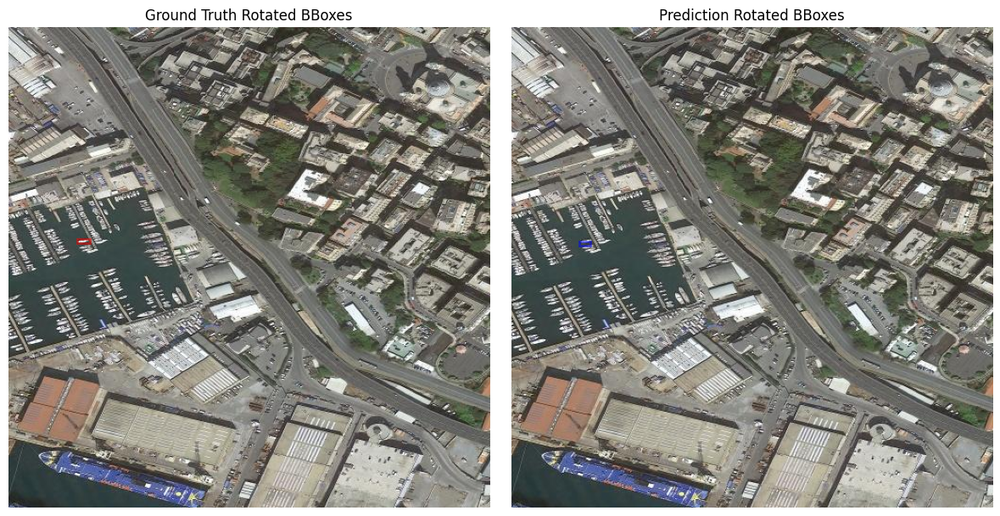


Image ID: 0334__512__4120___824.png
Question: [reasoning]Please locate all the objects that are <rel>driving in the opposite direction with</rel> the storehouse and provide their coordinates.
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


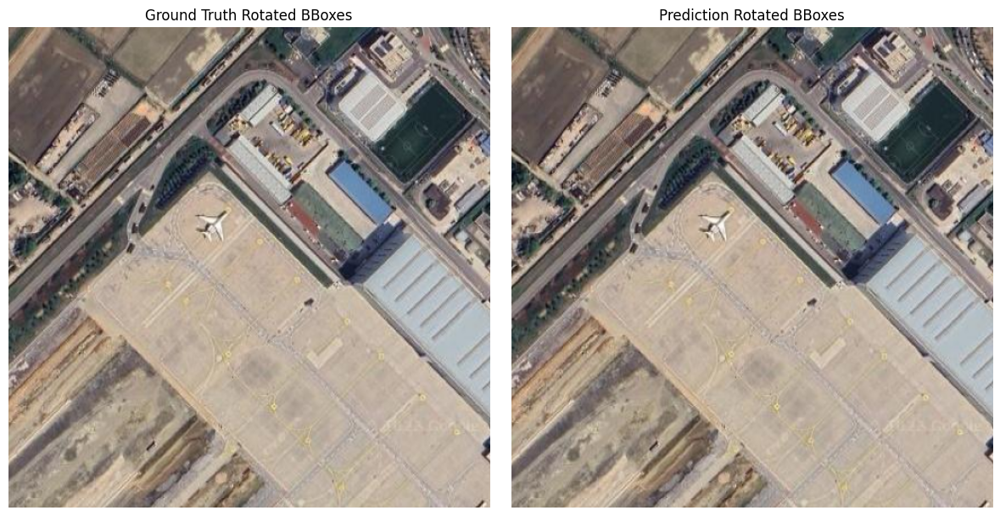

  1%|██▋                                                                                                                                                                                                                                      | 130/11174 [00:09<09:31, 19.32it/s]


Image ID: 0825__512__3708___3708.png
Question: [reasoning]Could you help me find all the objects that have a relationship of <rel>in the same parking with</rel> with the object in <rbox>({<92.87><33.79><6.64><3.71>|<90>})</rbox>? Please provide their locations and categories.
Answer: There is 1 object in total. All categories and coordinates: 1 car<rbox>({<88.67><33.50><6.45><3.52>|<90>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>car</ref><rbox>({<89.16><33.69><6.57><3.90>|<88>})</rbox>.
1 gt boxes; 1 prediction boxes


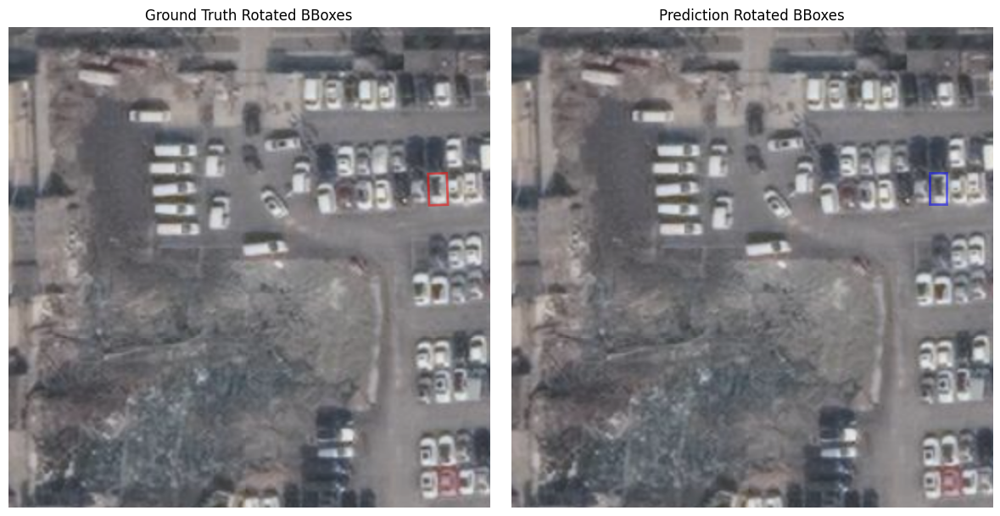

  1%|██▊                                                                                                                                                                                                                                      | 135/11174 [00:09<09:21, 19.66it/s]


Image ID: 0565__512__412___412.png
Question: [reasoning]Detect all the objects that have a relationship <rel>docking at the same breakwater with</rel> with the containment_vessel and output their locations.
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


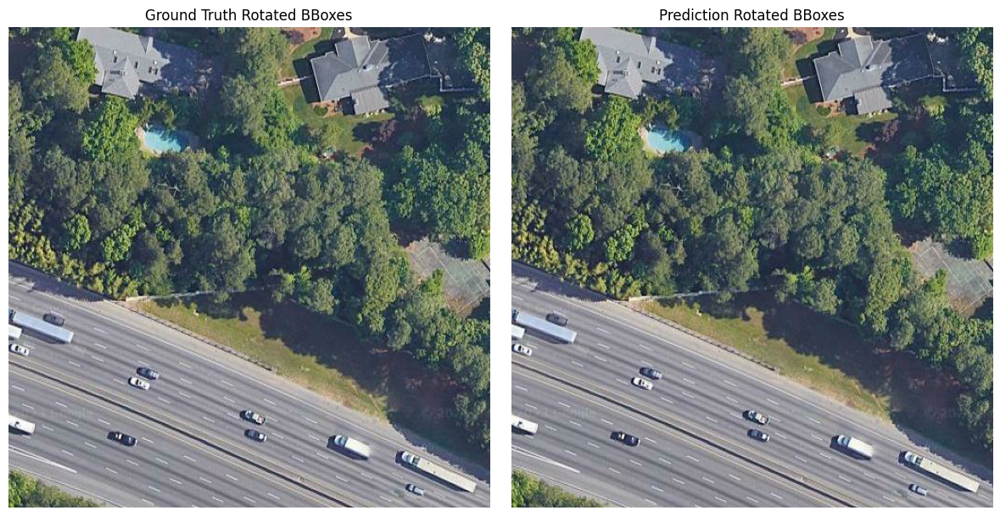

  1%|██▉                                                                                                                                                                                                                                      | 139/11174 [00:10<09:46, 18.82it/s]


Image ID: 0018__512__2060___2060.png
Question: [reasoning]Please detect all the boarding_bridges that are <rel>connect</rel> the <ref>terminal</ref> in location <rbox>({<88.23><21.57><46.27><34.87>|<38>})</rbox>. Output their positions.
Answer: There is 1 boarding_bridge in total. All coordinates: <rbox>({<97.85><11.43><5.77><5.95>|<66>})</rbox>.
Ground Truth: There are 2 boarding_bridges in total. All coordinates: <rbox>({<70.99><10.24><10.22><2.62>|<63>}, {<82.13><6.25><8.99><5.37>|<73>})</rbox>.
2 gt boxes; 1 prediction boxes


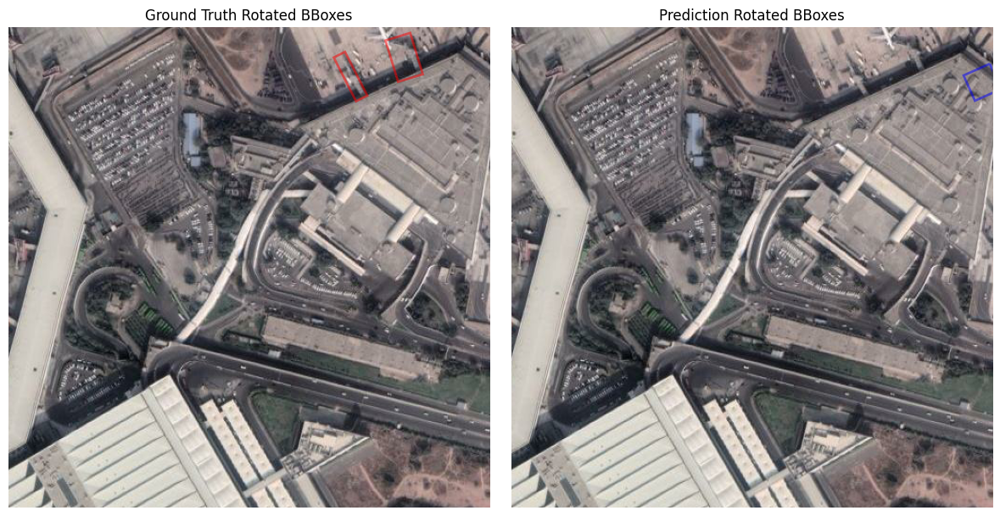

  1%|██▉                                                                                                                                                                                                                                      | 142/11174 [00:10<10:44, 17.12it/s]


Image ID: 0842__512__9888___4120.png
Question: [reasoning]Can you help me locate all the objects that are <rel>driving in the different lane with</rel> the car and give me their positions?
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: There are 2 objects in total. All coordinates: <rbox>({<8.40><66.60><2.88><6.42>|<62>}, {<16.45><73.42><2.62><7.08>|<63>})</rbox>.
2 gt boxes; 0 prediction boxes


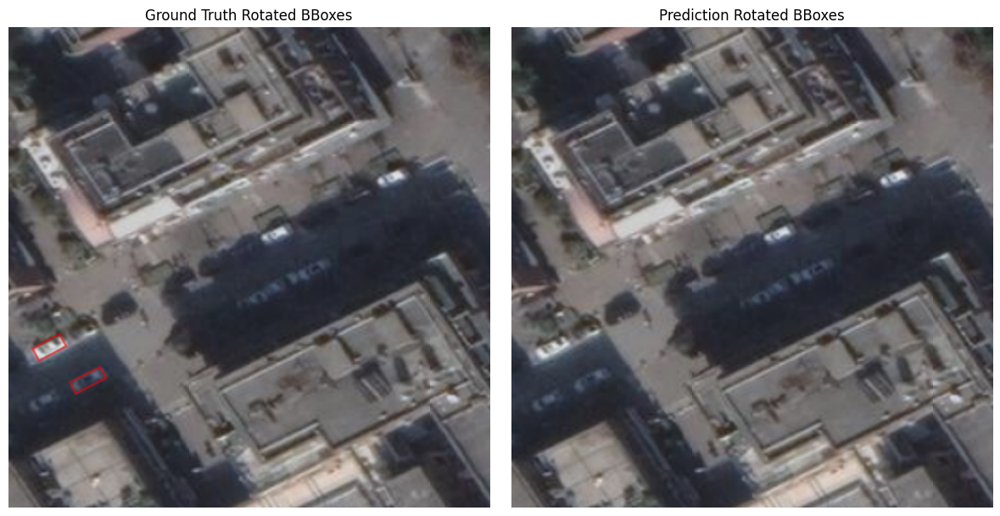


Image ID: 0020__512__1648___1236.png
Question: [reasoning]What objects have the relationship of <rel>running along the different taxiway with</rel> with the object present at <rbox>({<80.47><15.12><12.30><13.22>|<20>})</rbox>? Could you locate and classify them for me?
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>airplane</ref><rbox>({<73.24><89.84><14.91><13.46>|<21>})</rbox>.
1 gt boxes; 0 prediction boxes


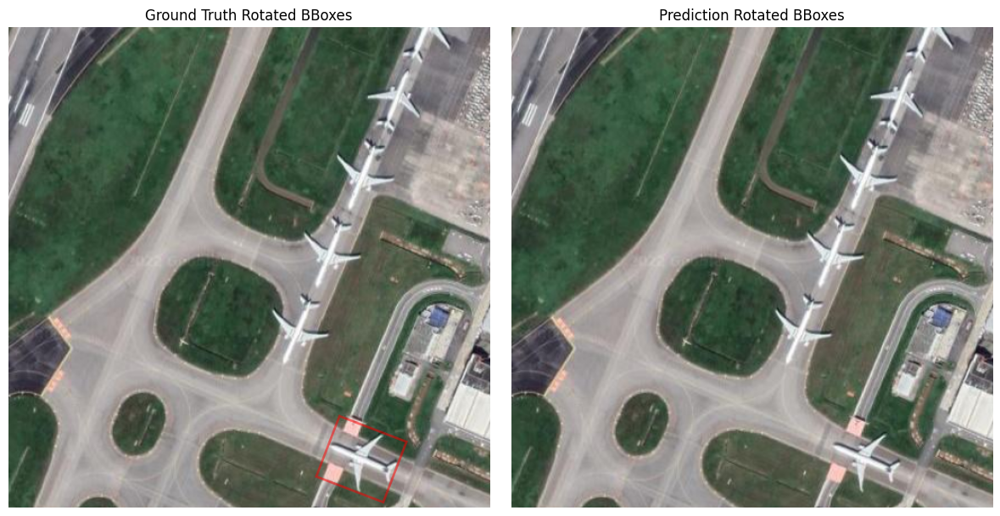

  1%|███                                                                                                                                                                                                                                      | 144/11174 [00:10<15:56, 11.54it/s]


Image ID: 0292__512__2060___412.png
Question: [reasoning]Can you help me locate all the objects that are <rel>in the different parking with</rel> the car and give me their positions?
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


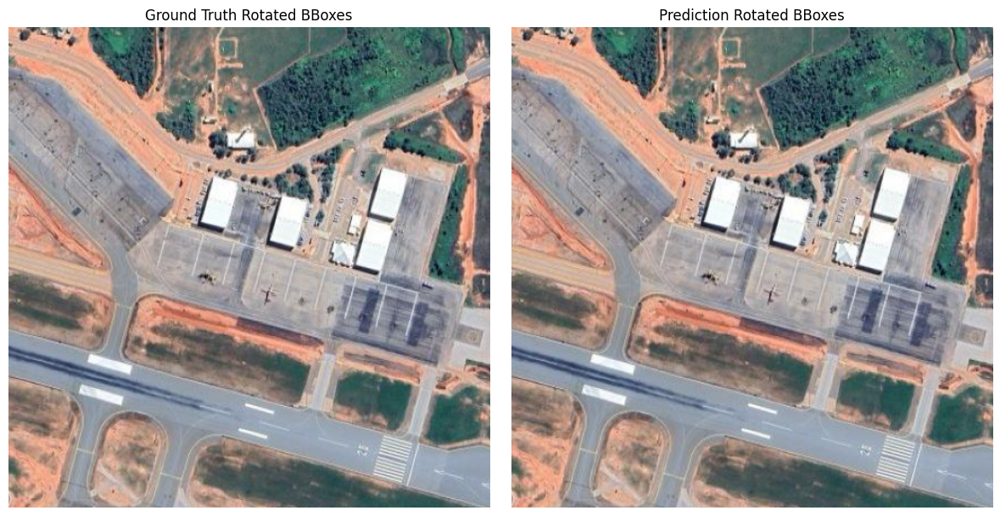

  1%|███                                                                                                                                                                                                                                      | 147/11174 [00:10<16:02, 11.46it/s]


Image ID: 0031__512__0___824.png
Question: [reasoning]Please locate all the objects that are <rel>docking at the same dock with</rel> the object present at <rbox>({<80.57><52.15><5.62><1.74>|<67>})</rbox> and provide their positions.
Answer: There is 1 object in total. All categories and coordinates: 1 boat<rbox>({<79.20><52.34><5.19><1.85>|<70>})</rbox>.
Ground Truth: There is 1 object in total. All coordinates: <rbox>({<84.86><59.18><15.50><2.37>|<41>})</rbox>.
1 gt boxes; 1 prediction boxes


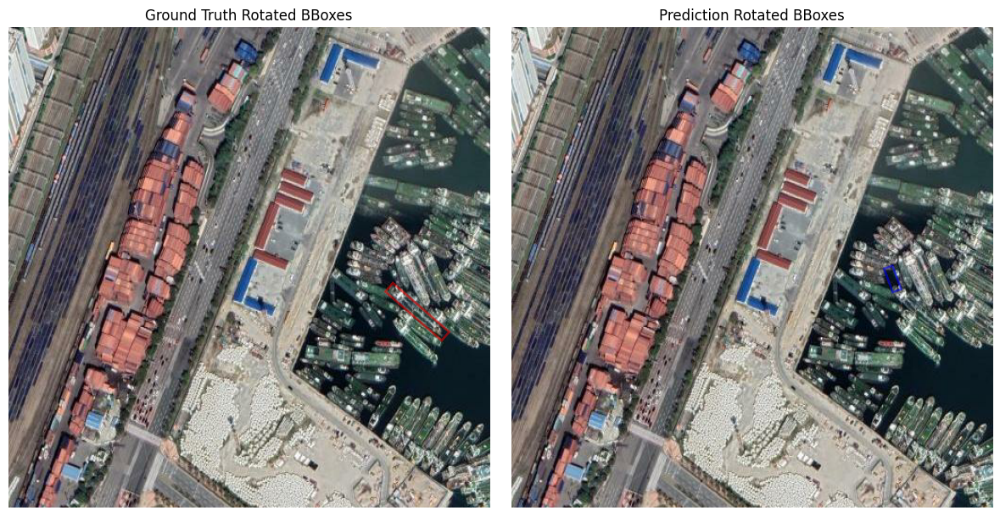

  1%|███                                                                                                                                                                                                                                      | 149/11174 [00:11<17:15, 10.65it/s]


Image ID: 0010__512__2060___1648.png
Question: [reasoning]There are some objects that are <rel>parking in the different apron with</rel> the <ref>airplane</ref> present at <rbox>({<85.45><95.80><13.09><13.09>|<90>})</rbox>. Could you tell me their locations and categories?
Answer: There are 2 objects in total. All categories and coordinates: 2 airplanes<rbox>({<84.18><11.82><15.23><16.96>|<88>}, {<77.44><32.13><15.42><14.84>|<88>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>airplane</ref><rbox>({<86.04><12.79><15.10><16.91>|<84>})</rbox>.
1 gt boxes; 2 prediction boxes


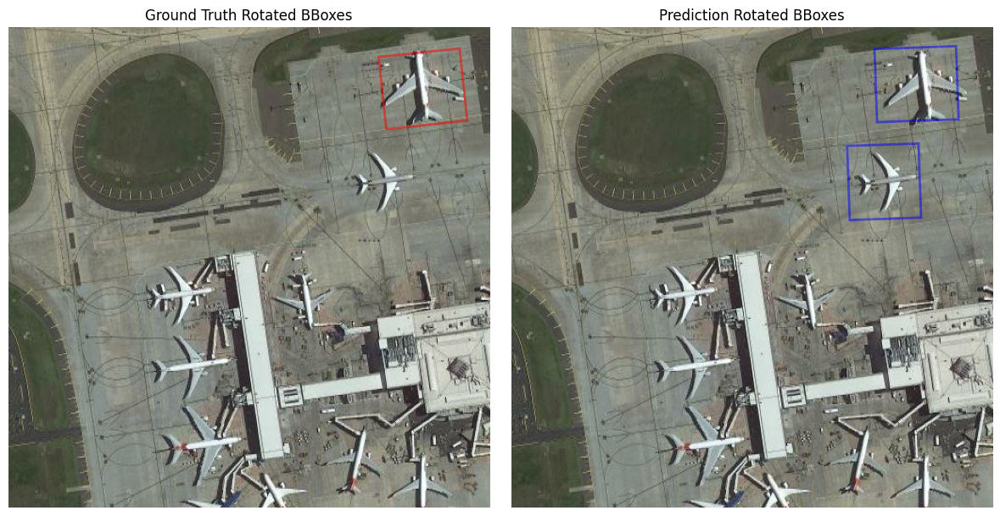

  1%|███▏                                                                                                                                                                                                                                     | 153/11174 [00:11<14:49, 12.39it/s]


Image ID: 0004__512__2884___4532.png
Question: [reasoning]There are some objects that are <rel>parked alongside with</rel> the airplane. Could you tell me their locations?
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: There are 2 objects in total. All coordinates: <rbox>({<50.36><20.33><14.56><16.62>|<23>}, {<43.05><37.59><13.79><12.26>|<22>})</rbox>.
2 gt boxes; 0 prediction boxes


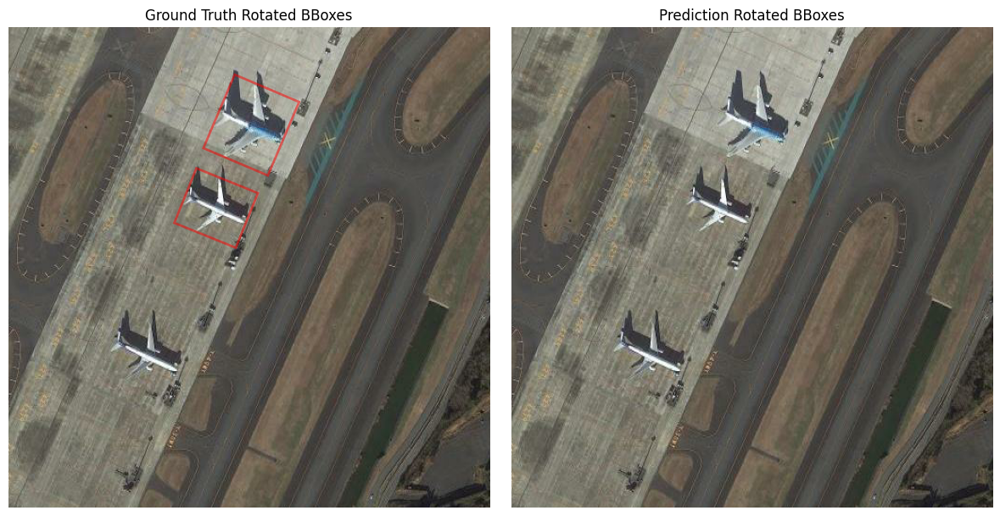

  1%|███▎                                                                                                                                                                                                                                     | 157/11174 [00:11<13:22, 13.72it/s]


Image ID: 0873__512__6592___4944.png
Question: [reasoning]Output the positions of all objects that have a relationship of <rel>approach</rel> with the <ref>car</ref> present at <rbox>({<62.97><34.37><7.82><3.13>|<2>})</rbox>.
Answer: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
Ground Truth: I'm sorry, I cannot answer as there are no objects that satisfy the conditions.
0 gt boxes; 0 prediction boxes


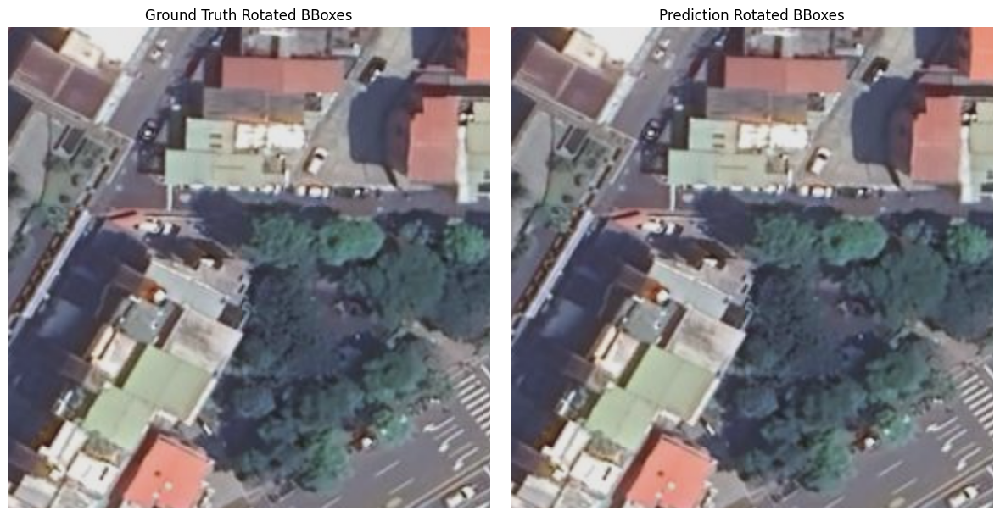

  1%|███▎                                                                                                                                                                                                                                     | 161/11174 [00:11<12:32, 14.63it/s]


Image ID: 0873__512__7004___1648.png
Question: [reasoning]I want to know the coordinates and categories of all the objects <rel>parked alongside with</rel> the object in <rbox>({<84.24><68.78><6.82><2.62>|<23>})</rbox>.
Answer: There is 1 object in total. All categories and coordinates: 1 car<rbox>({<85.35><65.72><7.22><2.97>|<22>})</rbox>.
Ground Truth: There is 1 object in total. All categories and coordinates: 1 <ref>car</ref><rbox>({<82.36><71.40><6.55><3.23>|<25>})</rbox>.
1 gt boxes; 1 prediction boxes


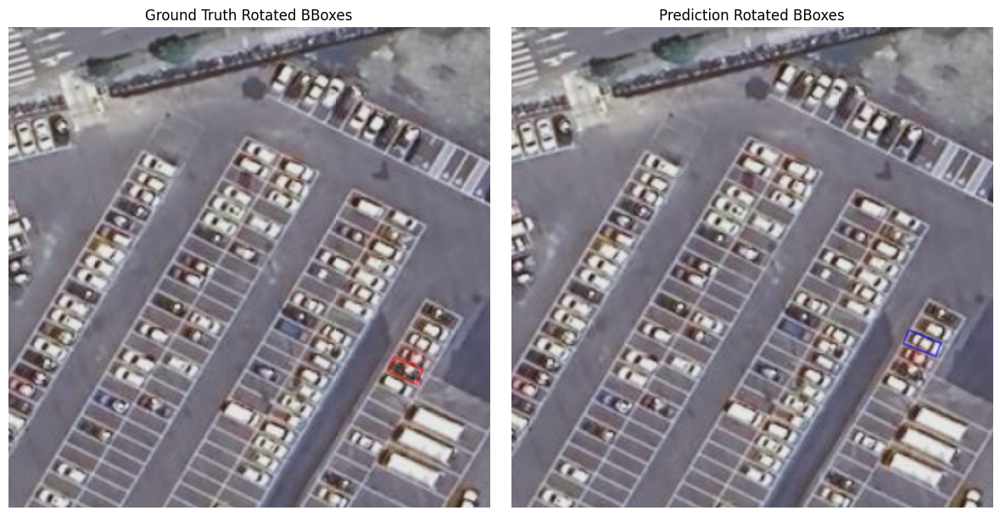


Image ID: 0104__512__3708___2060.png
Question: [reasoning]Find all the airplanes that have a relationship of <rel>parking in the different apron with</rel> with the airplane. Can you give me their positions?
Answer: There is 1 airplane in total. All coordinates: <rbox>({<48.63><56.35><12.92><12.38>|<44>})</rbox>.
Ground Truth: There is 1 airplane in total. All coordinates: <rbox>({<63.09><41.31><15.66><12.30>|<43>})</rbox>.
1 gt boxes; 1 prediction boxes


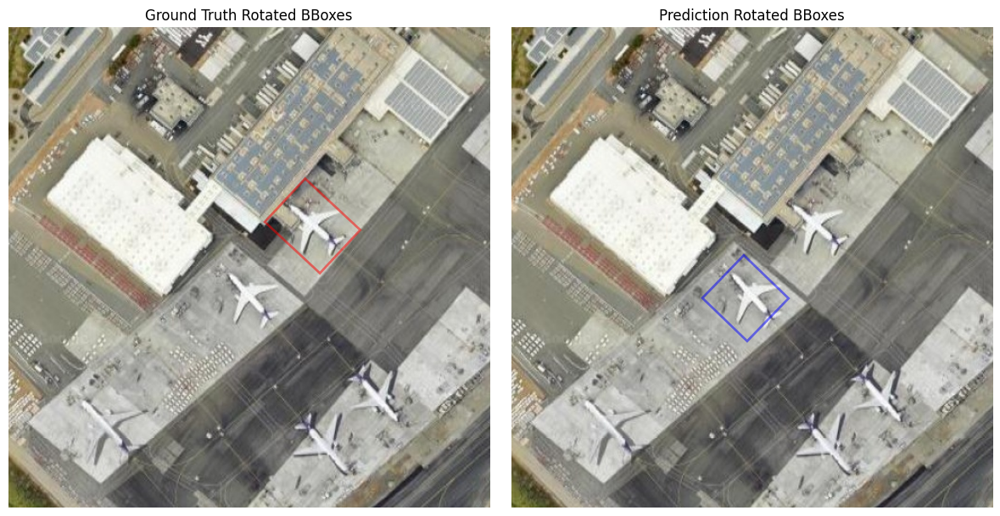

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 11174/11174 [00:12<00:00, 894.57it/s]

[2024-12-26 16:08:14,123] [INFO] [real_accelerator.py:191:get_accelerator] Setting ds_accelerator to cuda (auto detect)
[2024-12-26 16:08:14,132] [INFO] [real_accelerator.py:191:get_accelerator] Setting ds_accelerator to cuda (auto detect)
[2024-12-26 16:08:14,142] [INFO] [real_accelerator.py:191:get_accelerator] Setting ds_accelerator to cuda (auto detect)
[2024-12-26 16:08:14,180] [INFO] [real_accelerator.py:191:get_accelerator] Setting ds_accelerator to cuda (auto detect)

+-------+------+------+--------+-------+
| class | gts  | dets | recall | ap    |
+-------+------+------+--------+-------+
| 0     | 198  | 0    | 0.000  | 0.000 |
| 1     | 3775 | 2037 | 0.273  | 0.149 |
| 2     | 11   | 0    | 0.000  | 0.000 |
| 3     | 16   | 0    | 0.000  | 0.000 |
| 4     | 59   | 0    | 0.000  | 0.000 |
| 5     | 100  | 0    | 0.000  | 0.000 |
| 6     | 9    | 0    | 0.000  | 0.000 |
| 7     | 429  | 0    | 0.000  | 0.000 |
| 8     | 4    | 0    | 0.000  | 0.000 |
| 9     | 0    | 0    | 0.0

In [20]:
parse_gt_answer_investigate(qagt_dict, fit_image_root, task_id="task4", vis_num=50)

In [21]:
label_id

['airplane',
 'boat',
 'taxiway',
 'boarding_bridge',
 'tank',
 'ship',
 'crane',
 'car',
 'apron',
 'dock',
 'storehouse',
 'goods_yard',
 'truck',
 'terminal',
 'runway',
 'breakwater',
 'car_parking',
 'bridge',
 'cooling_tower',
 'truck_parking',
 'chimney',
 'vapor',
 'coal_yard',
 'genset',
 'smoke',
 'gas_station',
 'lattice_tower',
 'substation',
 'containment_vessel',
 'flood_dam',
 'ship_lock',
 'gravity_dam',
 'arch_dam',
 'cement_concrete_pavement',
 'toll_gate',
 'tower_crane',
 'engineering_vehicle',
 'unfinished_building',
 'foundation_pit',
 'wind_mill',
 'intersection',
 'roundabout',
 'ground_track_field',
 'soccer_ball_field',
 'basketball_court',
 'tennis_court',
 'baseball_diamond',
 'stadium']